In [5]:
import yaml
import torch
from IMPA.dataset.data_loader import CellDataLoader
from IMPA.solver import IMPAmodule
import pandas as pd
from omegaconf import OmegaConf
import scanpy as sc
import seaborn as sns

import numpy as np
import IMPA.featurizer.vision_transformer as vits
from tqdm import tqdm
import seaborn as sns
import matplotlib.pyplot as plt
from pathlib import Path
import sys
import pickle as pkl
from matplotlib import rcParams
FIGSIZE=(3,3)               
rcParams['figure.figsize']=FIGSIZE

**Plotting function**

In [6]:
def pca_umap_plot_with_preprocessing(adata, title, batch_name):
    sc.settings.figdir = "/home/icb/alessandro.palma/environment/IMPA/IMPA/notebooks/cpg0000/corrections_old_paper/plots/"

    # Set a random seed for reproducibility
    np.random.seed(0)

    # Randomly permute the indices
    random_indices = np.random.permutation(list(range(adata.shape[0])))

    # Set a color palette for better color representation
    sns.set_palette("colorblind")

    # Plot the PCA with random reordering
    sc.pl.pca(adata[random_indices, :], color=batch_name, title=title, s=30)

    # Plot the UMAP with random reordering
    sc.pl.umap(adata[random_indices, :], color=batch_name, title=title, s=30)

    # Show the plots
    plt.show()

def initalize_stargan(config_dict, number):
    """Initialize the starGANv1 model 

    Args:
        path (str): path to the .yml configuration file for the experiment 
        number (int): number of the iteration to reload
    """
    sys.path = sys.path[:6]
    sys.path.append('/home/icb/alessandro.palma/environment/IMPA/stargan/')
    from solver_stargan import Solver as solver_stargan
    print(sys.path)
    args_stargan = Args(config_dict)
    solver = solver_stargan(args_stargan)
    solver.restore_model(number)
    return solver

class Args(dict):
    def __init__(self, *args, **kwargs):
        super(Args, self).__init__(*args, **kwargs)
        self.__dict__ = self

**Code**

**Featurize RxRx1 before and after batchn transformation**

In [7]:
args_impa = {'task_name': 'rxrx1_batch',
            # IMAGE
            'img_size': 96,
            'latent_dim': 100,
            'hidden_dim': 512,
            'style_dim': 64,
            'stochastic': True,
            'z_dimension': 10,
            'dim_in': 64,
            'pert_modelling': False,
            'batch_key': 'BATCH',
            'subsample_frac': 1.0,
        
            # LOSS
            'lambda_reg': 1,
            'lambda_cyc': 1,
            'lambda_sty': 1,
            'lambda_ds': 1,
        
            # TRAINING
            'total_epochs': 100,
            'ds_iter': 100000,
            'resume_iter': 0,
            'batch_size': 32,
            'val_batch_size': 20,
            'lr': 0.0001,
            'f_lr': 0.0001,
            'beta1': 0,
            'beta2': 0.99,
            'weight_decay': 0.0001,
            'num_outs_per_domain': 10,
            'single_style': True,
            'ood_set': None,
            'mol_list': None,
            'balanced': False,
            'trainable_emb': True,
            'dataset_name': 'rxrx1',
            'n_channels': 6,
            'num_workers': 6,
            'seed': 42,
        
            # DIRECTORIES FOR DATA
            'image_path': '/home/icb/alessandro.palma/environment/IMPA/IMPA/project_folder/datasets/rxrx1',
            'data_index_path': '/home/icb/alessandro.palma/environment/IMPA/IMPA/project_folder/datasets/rxrx1/metadata/rxrx1_df.csv',
            'embedding_path': None,
        
            # DIRECTORIES FOR RESULTS
            'experiment_directory': '../project_folder/experiments/',
            'sample_dir': 'sample',
            'checkpoint_dir': 'checkpoint',
            'basal_vs_real_folder': 'basal_vs_real',
            'naming_key': 'dataset_name',
            'embedding_folder': 'embeddings',
            'resume_dir': '',
        
            # DATA HANDLEMENT
            'augment_train': True,
            'normalize': True,
        
            # LOGGING INFO
            'print_every': 10,
            'sample_every': 1000,
            'save_every': 500,
            'eval_every': 500,
        
            # PARAMETERS FOR CONDITION ENCODING
            'encode_rdkit': True,
            'num_layers_mapping_net': 1,
        
            # Lightning
            'filename': 'epoch_{epoch:04d}',
            'monitor': 'fid_transformations',
            'mode': 'min',
            'save_last': True,
            'offline': False,
            'project': 'rxrx1_batch',
            'log_model': False,
            'accelerator': 'gpu',
            'log_every_n_steps': 10
    }

args_stargan = {"batch_size": 8,
        "val_batch_size": 10,
        "num_workers": 6,
        "image_path": "/home/icb/alessandro.palma/environment/IMPA/IMPA/project_folder/datasets/rxrx1",
        "data_index_path": "/home/icb/alessandro.palma/environment/IMPA/IMPA/project_folder/datasets/rxrx1/metadata/rxrx1_df.csv",
        "embedding_path": "",
        "augment_train": True,
        "normalize": True,
        "balanced": True,
        "batch_correction": True,
        "batch_key": "BATCH",
        "dim_in": 6,
        "c_dim": 3,
        "image_size": 96,
        "g_conv_dim": 64,
        "d_conv_dim": 64,
        "g_repeat_num": 6,
        "d_repeat_num": 5,
        "lambda_cls": 1,
        "lambda_rec": 10,
        "lambda_gp": 10,
        "num_iters": 300000,
        "num_iters_decay": 100000,
        "g_lr": 0.0001,
        "d_lr": 0.0001,
        "n_critic": 5,
        "beta1": 0.5,
        "beta2": 0.999,
        "resume_iters": None,
        "mode": "train",
        "use_tensorboard": False,
        "log_dir": "/lustre/groups/ml01/workspace/alessandro.palma/stargan/recursion_batch/logs",
        "model_save_dir": "/lustre/groups/ml01/workspace/alessandro.palma/stargan/recursion_batch/models",
        "sample_dir": "/lustre/groups/ml01/workspace/alessandro.palma/stargan/recursion_batch/samples",
        "result_dir": "/lustre/groups/ml01/workspace/alessandro.palma/stargan/recursion_batch/results",
        "log_step": 500,
        "sample_step": 500,
        "model_save_step": 5000,
        "lr_update_step": 1000,
        "mol_list": None,
        "ood_set": None,
        "dataset_name": "recursion",
        "trainable_emb": True, 
        "latent_dim": 10,
        "pert_modelling": False, 
        "n_channels": False,
        "dataset_name": "rxrx1"
}
    
args_impa = OmegaConf.create(args_impa)
args_stargan = OmegaConf.create(args_stargan)

In [8]:
dataloader = CellDataLoader(args_impa)

None
None


## Initialize solvers

In [9]:
dest_dir = "/lustre/groups/ml01/workspace/alessandro.palma/stargan/recursion_batch/models/"
solver_stargan = initalize_stargan(args_stargan, 300000)

dest_dir = "/home/icb/alessandro.palma/environment/IMPA/IMPA/project_folder/experiments/20231220_cbfc860a-2302-457a-b6d9-732d5b776510_rxrx1_batch"
solver_impa = IMPAmodule(args_impa, dest_dir, dataloader)
solver_impa._load_checkpoint(13)

['/home/icb/alessandro.palma/IMPA/stargan', '/ictstr01/home/icb/alessandro.palma/environment/IMPA/IMPA/notebooks/cpg0000', '/home/icb/alessandro.palma/miniconda3/envs/IMPA_try/lib/python39.zip', '/home/icb/alessandro.palma/miniconda3/envs/IMPA_try/lib/python3.9', '/home/icb/alessandro.palma/miniconda3/envs/IMPA_try/lib/python3.9/lib-dynload', '', '/home/icb/alessandro.palma/miniconda3/envs/IMPA_try/lib/python3.9/site-packages', '/home/icb/alessandro.palma/environment/IMPA/stargan/']
['/home/icb/alessandro.palma/IMPA/stargan', '/ictstr01/home/icb/alessandro.palma/environment/IMPA/IMPA/notebooks/cpg0000', '/home/icb/alessandro.palma/miniconda3/envs/IMPA_try/lib/python39.zip', '/home/icb/alessandro.palma/miniconda3/envs/IMPA_try/lib/python3.9', '/home/icb/alessandro.palma/miniconda3/envs/IMPA_try/lib/python3.9/lib-dynload', '', '/home/icb/alessandro.palma/miniconda3/envs/IMPA_try/lib/python3.9/site-packages', '/home/icb/alessandro.palma/environment/IMPA/stargan/']
Lodading the data...
Loa

In [10]:
train_dataloader = dataloader.train_dataloader()
val_dataloader = dataloader.val_dataloader()

In [11]:
X_after_transf_impa = []
X_after_transf_stargan = []
X_before_transf = []
real_batch = []

# Transform all with the same random vector. Take the mean 
z_common = torch.randn(1, 100, args_impa.z_dimension).mean(1).cuda()
with torch.no_grad():
    for batch in tqdm(val_dataloader):
        # # Get image 
        X = batch["X"].cuda()
        real_batch.append(batch["mol_one_hot"].argmax(1))

        # IMPA
        z = z_common.repeat(X.shape[0], 1)
        y = 0*torch.ones(X.shape[0]).long().cuda()
        y = solver_impa.embedding_matrix(y).cuda()
        y = torch.cat([y, z], dim=1)
        y = solver_impa.nets.mapping_network(y)
        _, X_generated_impa = solver_impa.nets.generator(X, y)

        # StarGAN
        y = torch.zeros(X.shape[0], 3).long().cuda()
        y[:, 0] = 1
        X_generated_stargan = solver_stargan.G(X, y)

        X_before_transf.append(X.detach().cpu())
        X_after_transf_impa.append(X_generated_impa.detach().cpu())
        X_after_transf_stargan.append(X_generated_stargan.detach().cpu())

100%|██████████| 1714/1714 [02:02<00:00, 13.96it/s]


In [12]:
X_before_transf = torch.cat(X_before_transf, dim=0)
X_after_transf_impa = torch.cat(X_after_transf_impa, dim=0)
X_after_transf_stargan = torch.cat(X_after_transf_stargan, dim=0)

In [13]:
real_batch =  torch.cat(real_batch)
X_before_transf_0 = X_before_transf[real_batch==0]
X_before_transf_1 = X_before_transf[real_batch==1]
X_before_transf_2 = X_before_transf[real_batch==2]

0


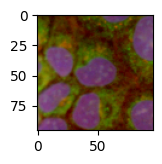

1


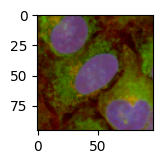

2


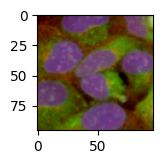

3


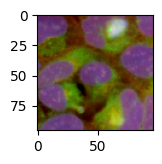

4


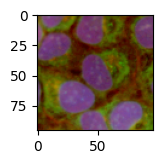

5


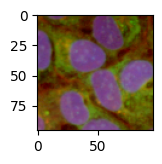

6


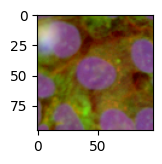

7


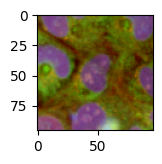

8


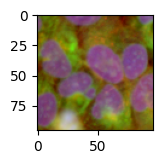

9


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


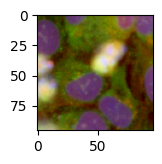

10


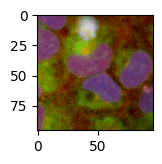

11


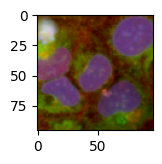

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


12


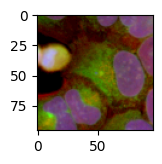

13


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


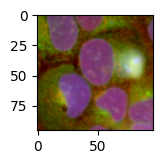

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


14


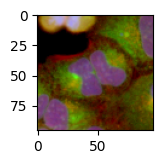

15


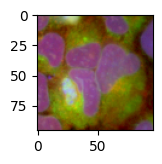

16


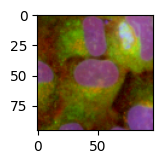

17


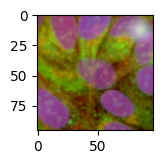

18


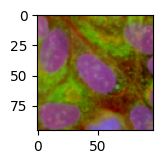

19


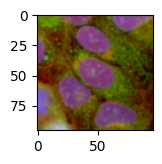

20


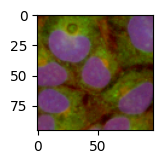

21


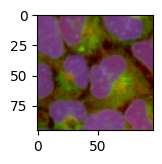

22


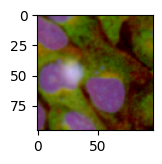

23


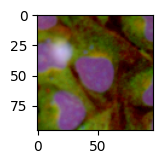

24


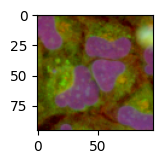

25


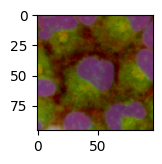

26


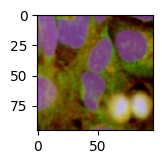

27


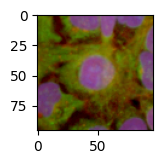

28


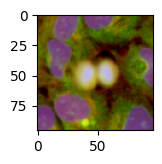

29


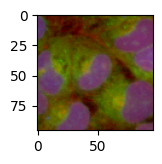

30


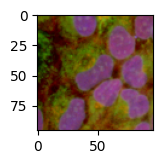

31


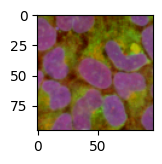

32


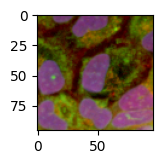

33


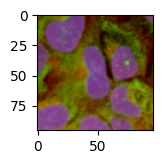

34


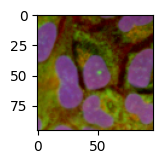

35


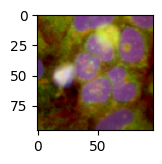

36


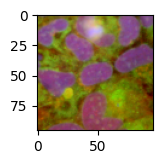

37


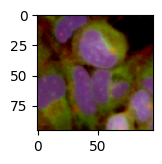

38


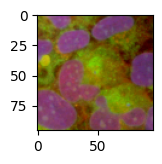

39


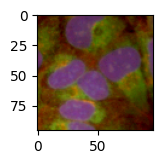

40


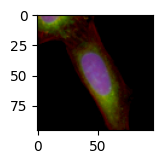

41


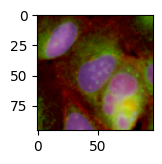

42


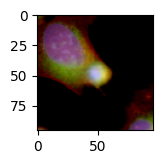

43


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


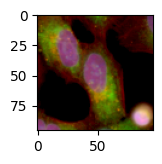

44


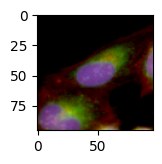

45


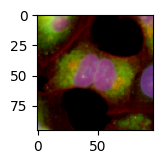

46


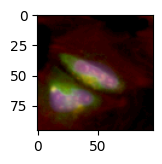

47


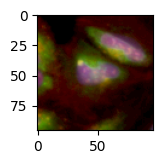

48


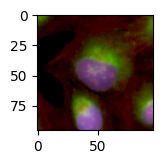

49


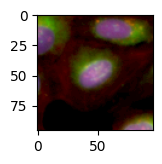

50


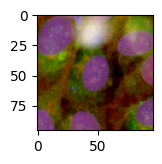

51


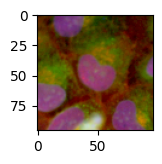

52


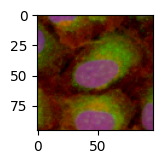

53


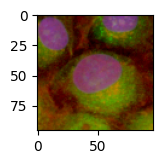

54


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


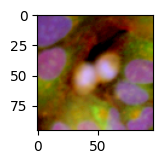

55


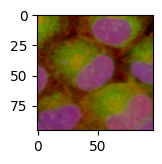

56


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


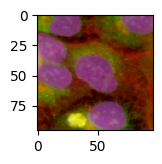

57


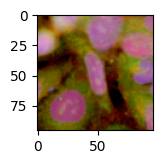

58


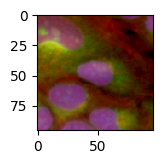

59


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


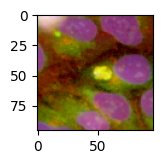

60


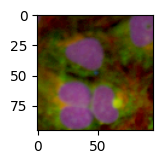

61


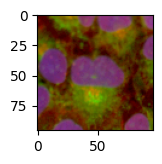

62


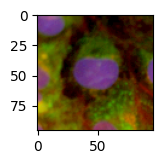

63


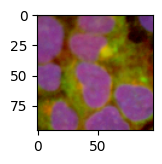

64


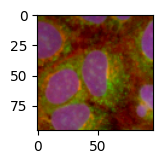

65


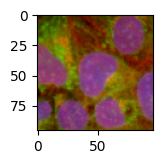

66


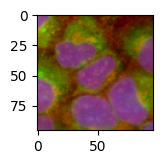

67


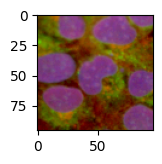

68


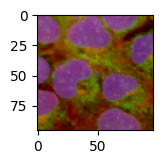

69


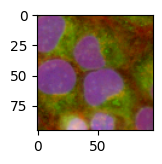

70


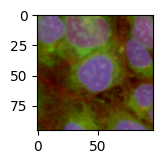

71


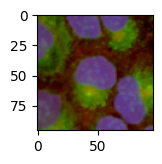

72


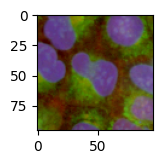

73


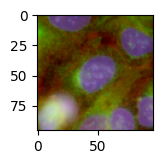

74


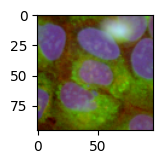

75


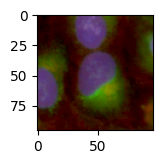

76


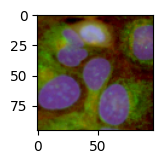

77


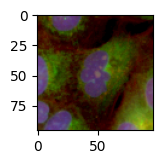

78


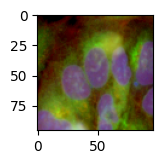

79


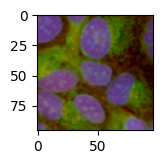

80


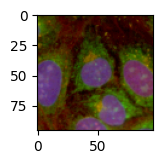

81


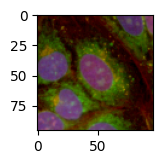

82


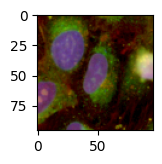

83


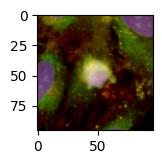

84


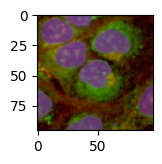

85


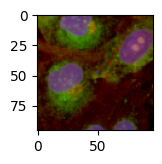

86


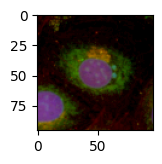

87


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


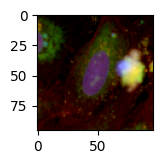

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


88


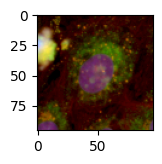

89


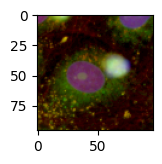

90


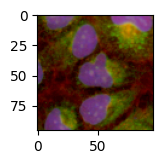

91


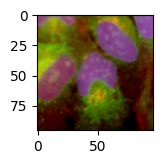

92


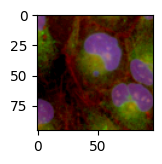

93


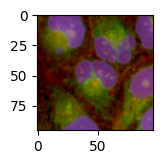

94


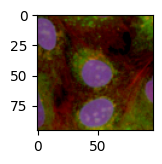

95


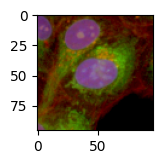

96


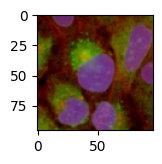

97


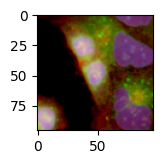

98


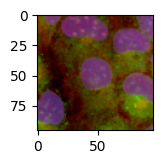

99


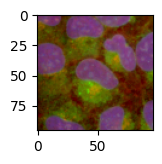

100


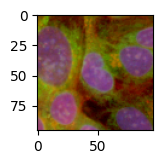

101


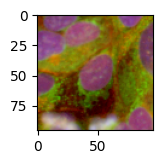

102


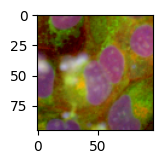

103


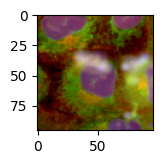

104


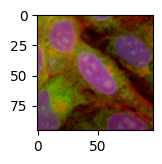

105


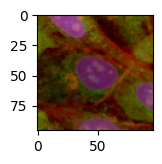

106


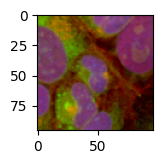

107


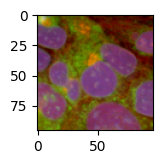

108


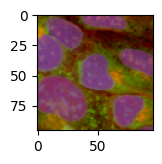

109


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


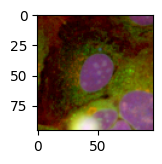

110


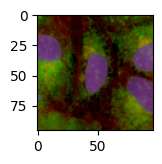

111


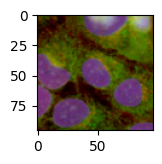

112


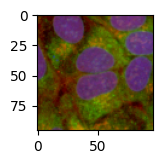

113


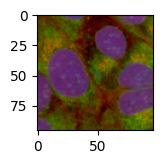

114


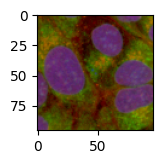

115


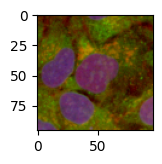

116


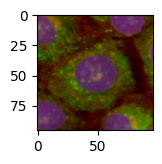

117


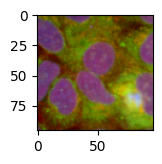

118


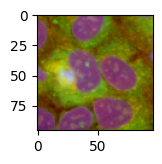

119


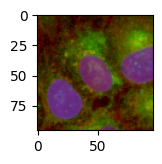

120


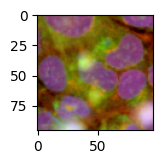

121


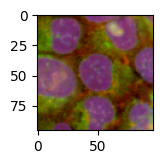

122


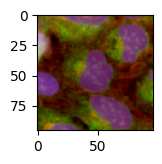

123


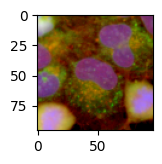

124


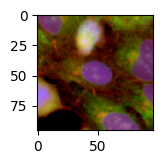

125


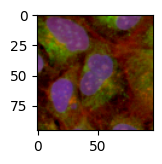

126


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


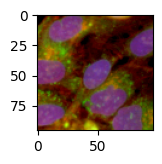

127


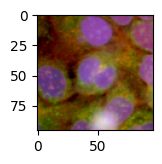

128


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


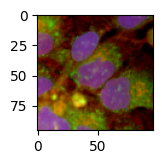

129


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


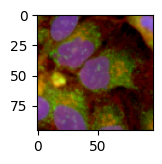

130


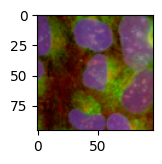

131


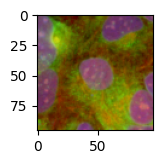

132


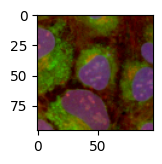

133


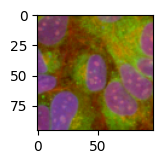

134


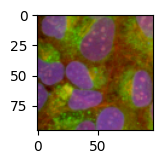

135


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


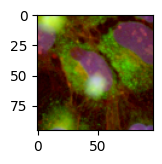

136


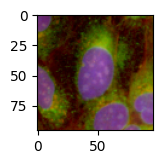

137


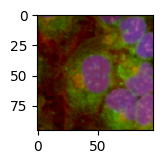

138


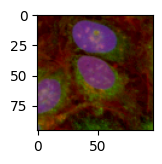

139


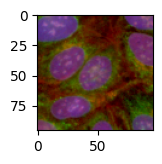

140


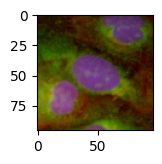

141


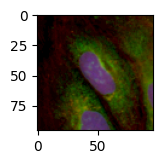

142


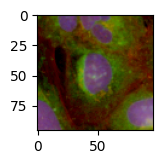

143


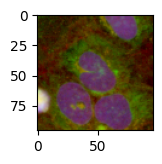

144


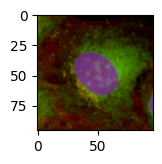

145


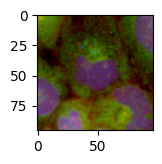

146


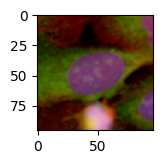

147


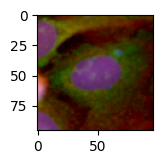

148


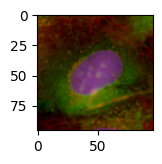

149


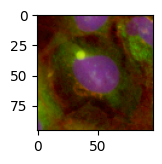

150


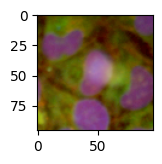

151


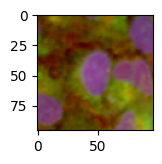

152


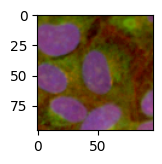

153


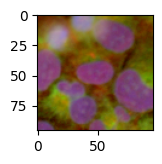

154


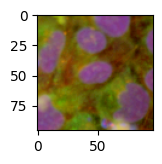

155


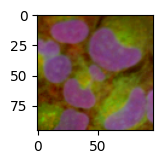

156


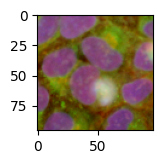

157


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


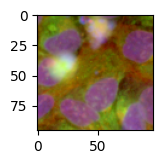

158


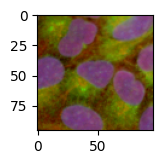

159


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


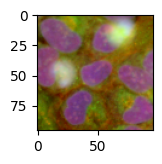

160


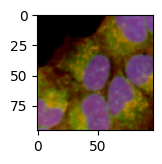

161


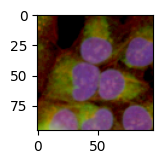

162


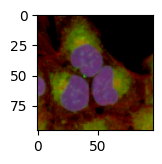

163


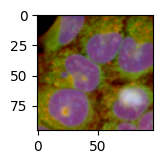

164


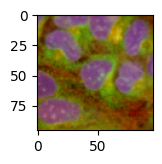

165


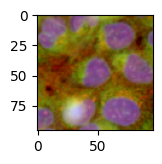

166


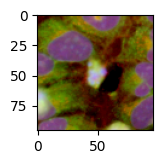

167


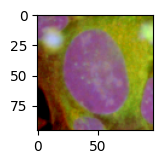

168


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


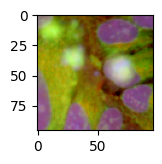

169


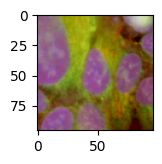

170


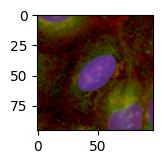

171


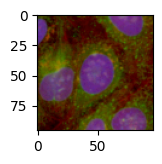

172


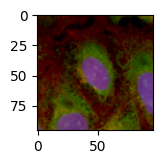

173


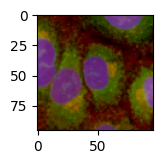

174


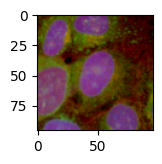

175


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


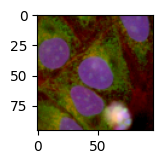

176


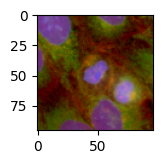

177


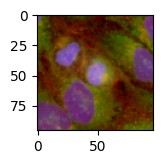

178


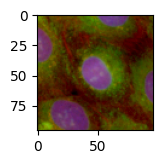

179


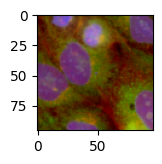

180


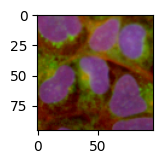

181


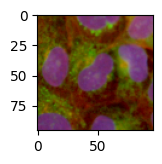

182


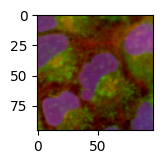

183


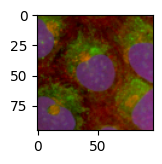

184


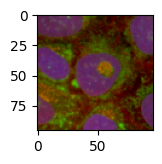

185


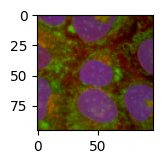

186


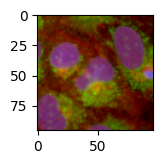

187


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


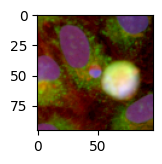

188


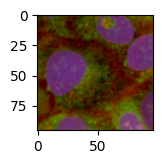

189


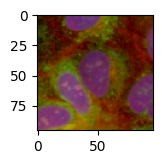

190


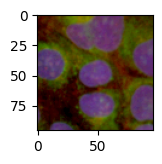

191


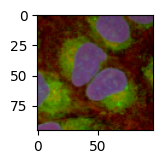

192


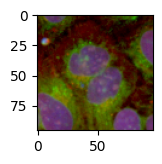

193


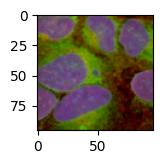

194


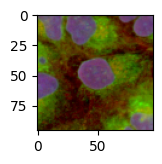

195


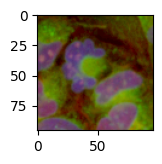

196


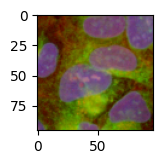

197


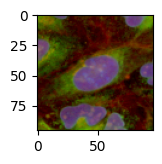

198


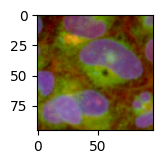

199


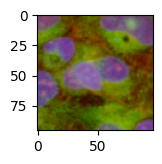

200


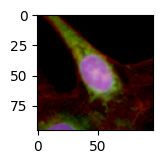

201


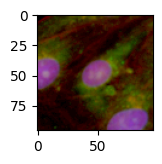

202


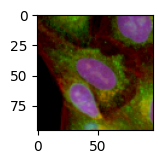

203


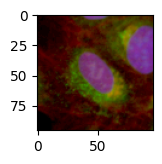

204


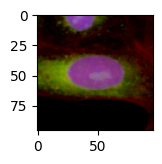

205


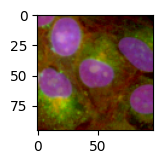

206


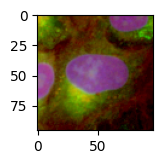

207


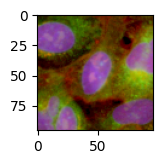

208


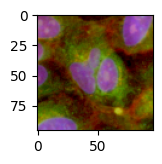

209


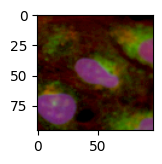

210


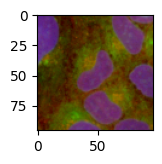

211


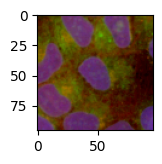

212


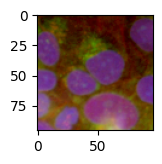

213


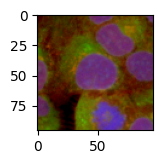

214


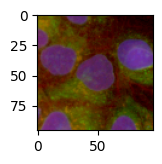

215


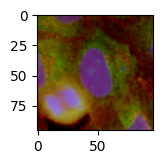

216


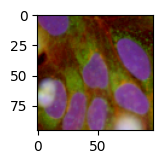

217


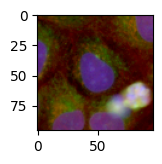

218


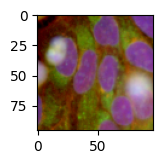

219


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


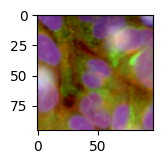

220


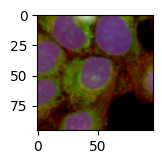

221


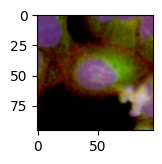

222


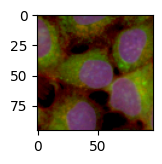

223


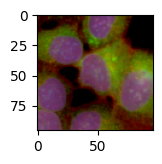

224


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


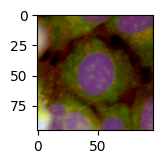

225


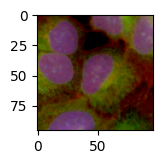

226


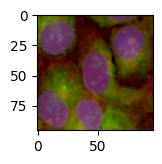

227


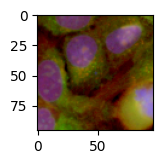

228


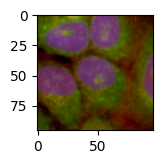

229


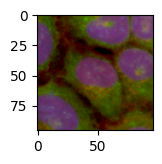

230


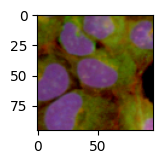

231


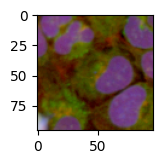

232


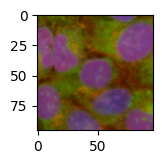

233


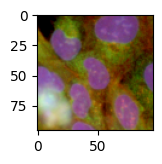

234


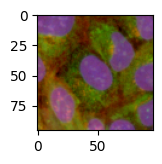

235


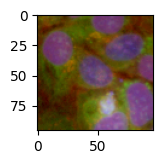

236


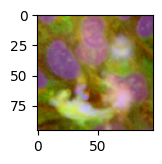

237


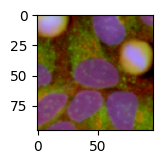

238


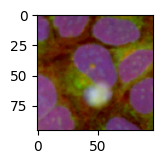

239


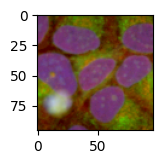

240


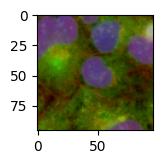

241


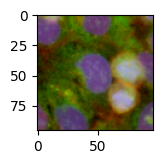

242


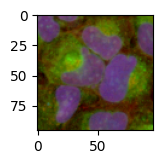

243


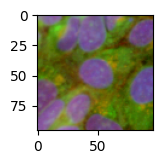

244


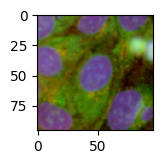

245


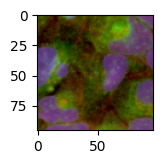

246


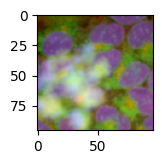

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


247


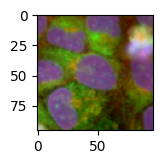

248


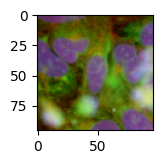

249


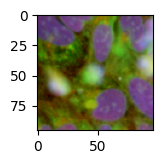

250


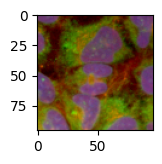

251


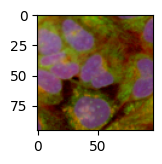

252


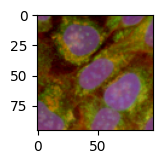

253


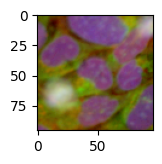

254


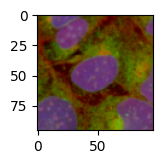

255


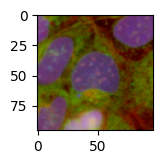

256


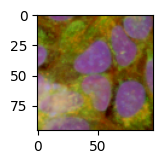

257


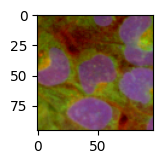

258


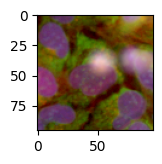

259


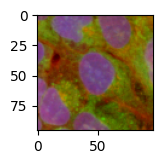

260


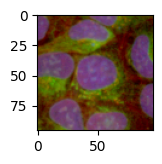

261


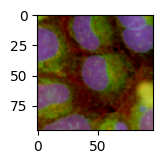

262


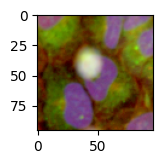

263


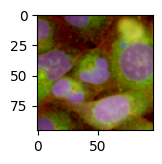

264


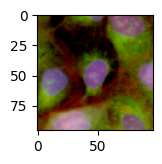

265


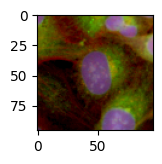

266


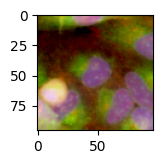

267


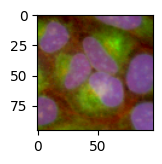

268


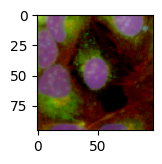

269


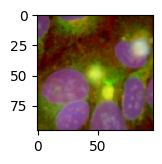

270


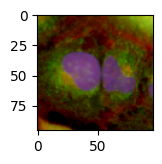

271


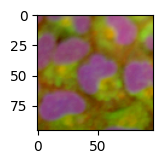

272


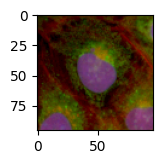

273


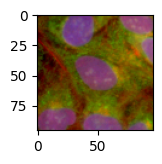

274


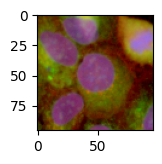

275


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


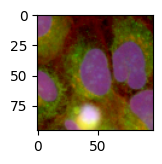

276


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


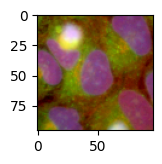

277


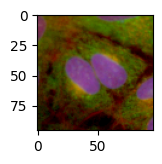

278


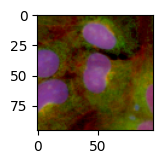

279


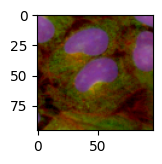

280


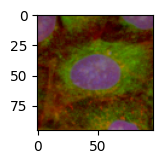

281


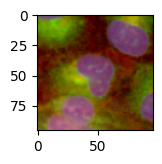

282


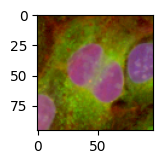

283


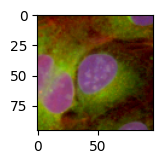

284


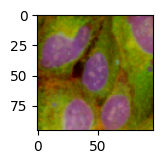

285


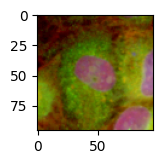

286


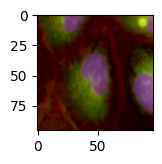

287


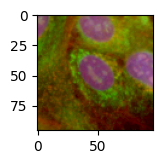

288


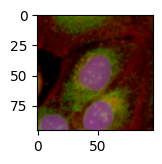

289


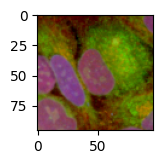

290


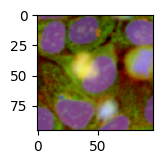

291


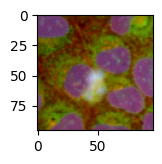

292


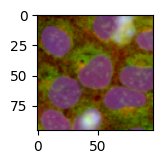

293


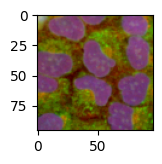

294


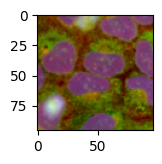

295


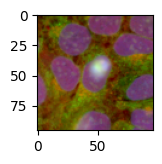

296


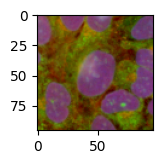

297


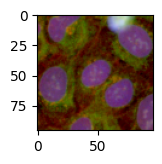

298


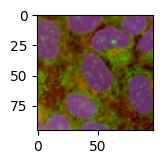

299


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


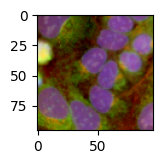

In [19]:
for i in range(300):
    print(i)
    plt.figure(figsize=(1.5,1.5))
    plt.imshow((X_before_transf[real_batch==1][i,[5, 1, 0],:,:].permute(1,2,0).cpu().numpy()+1)/2)
    plt.show()

0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


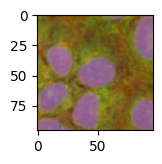

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1


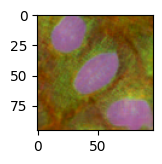

2


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


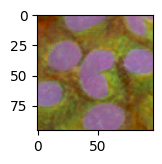

3


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


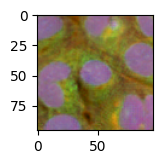

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


4


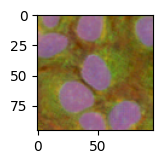

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


5


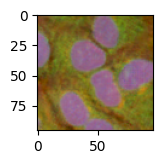

6


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


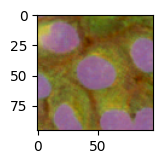

7


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


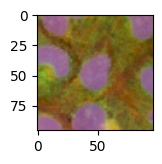

8


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


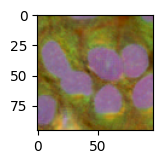

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


9


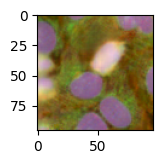

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


10


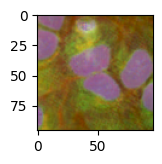

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


11


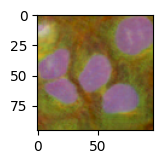

12


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


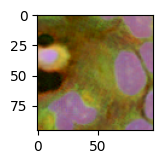

13


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


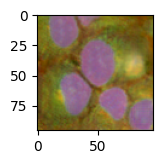

14


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


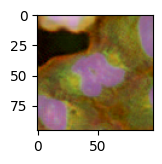

15


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


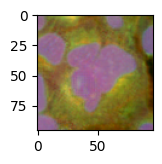

16


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


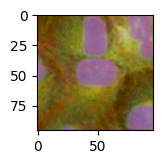

17


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


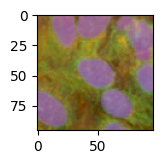

18


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


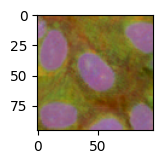

19


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


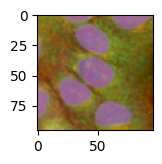

20


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


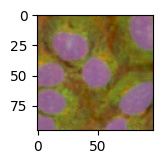

21


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


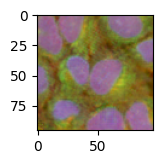

22


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


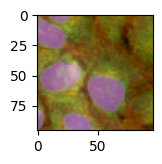

23


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


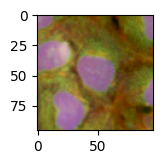

24


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


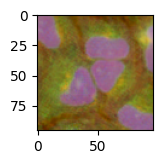

25


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


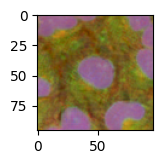

26


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


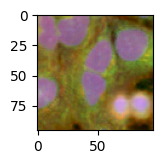

27


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


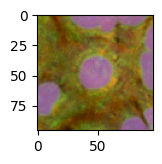

28


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


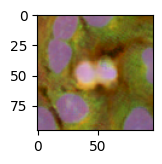

29


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


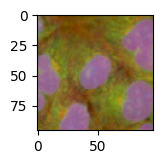

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


30


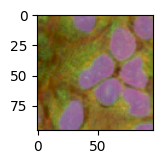

31


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


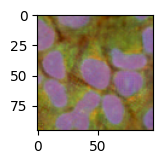

32


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


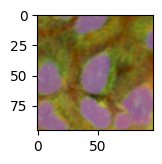

33


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


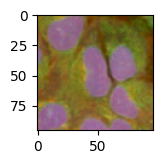

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


34


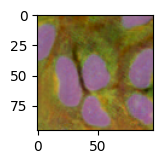

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


35


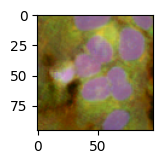

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


36


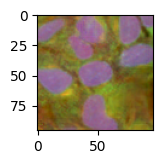

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


37


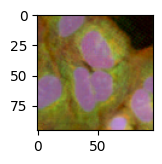

38


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


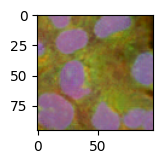

39


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


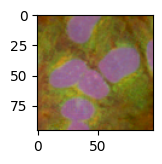

40


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


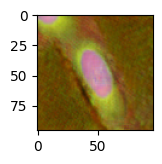

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


41


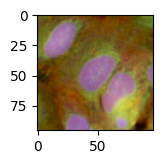

42


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


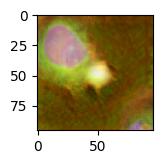

43


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


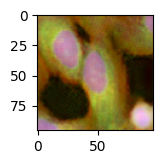

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


44


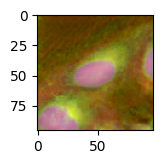

45


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


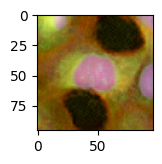

46


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


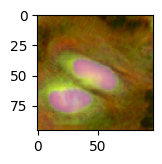

47


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


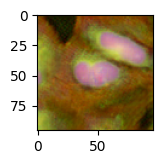

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


48


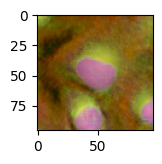

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


49


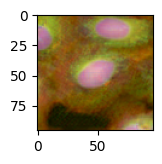

50


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


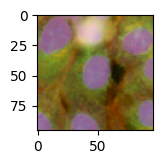

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


51


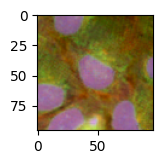

52


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


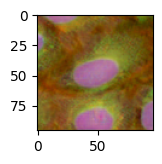

53


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


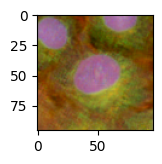

54


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


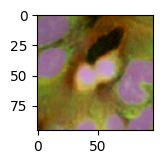

55


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


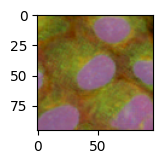

56


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


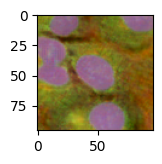

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


57


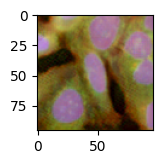

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


58


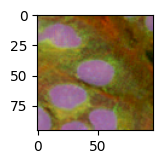

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


59


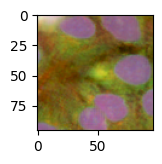

60


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


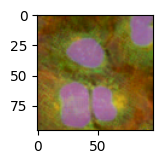

61


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


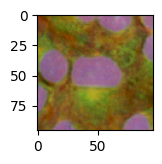

62


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


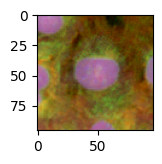

63


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


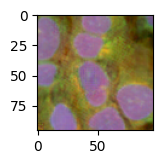

64


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


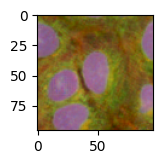

65


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


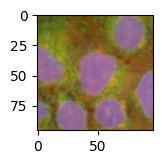

66


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


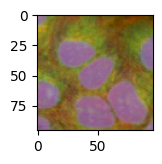

67


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


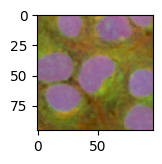

68


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


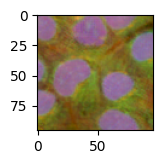

69


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


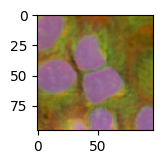

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


70


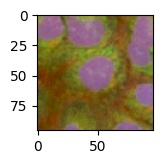

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


71


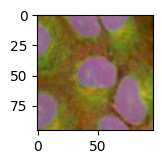

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


72


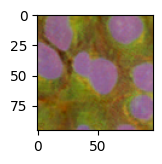

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


73


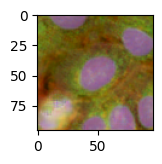

74


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


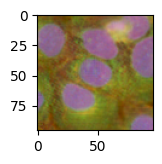

75


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


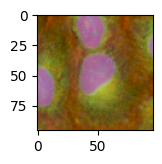

76


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


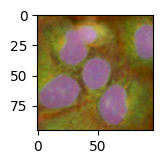

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


77


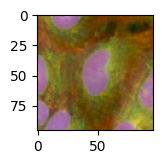

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


78


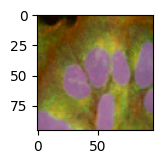

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


79


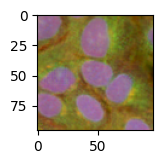

80


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


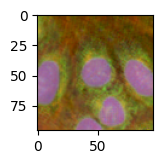

81


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


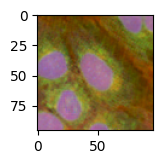

82


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


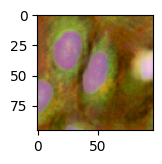

83


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


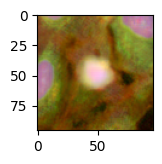

84


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


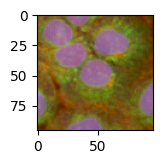

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


85


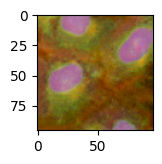

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


86


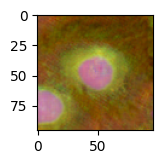

87


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


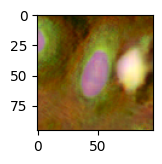

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


88


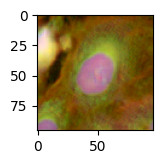

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


89


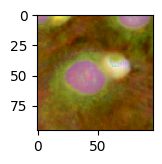

90


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


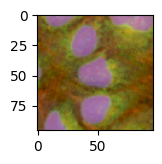

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


91


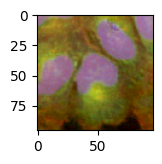

92


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


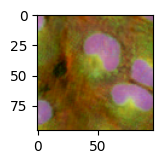

93


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


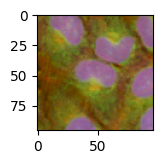

94


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


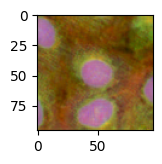

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


95


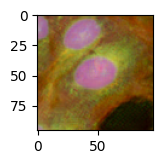

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


96


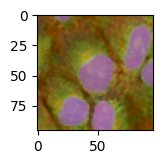

97


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


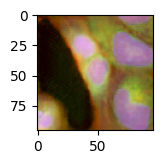

98


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


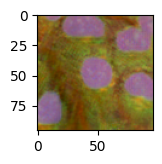

99


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


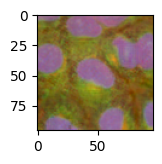

100


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


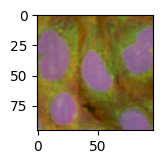

101


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


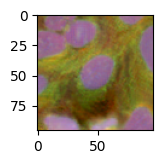

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


102


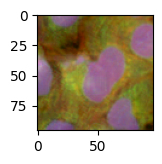

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


103


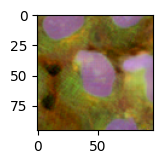

104


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


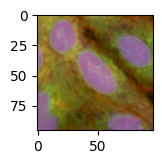

105


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


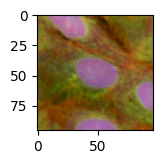

106


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


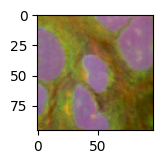

107


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


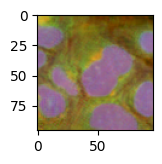

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


108


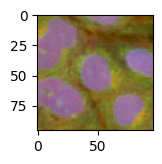

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


109


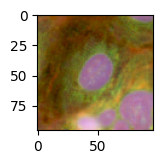

110


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


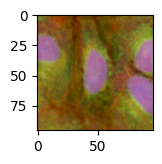

111


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


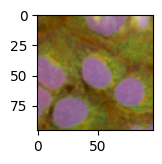

112


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


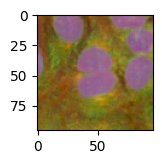

113


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


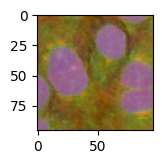

114


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


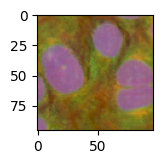

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


115


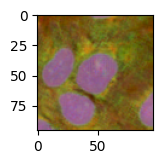

116


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


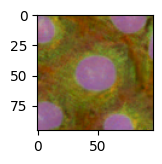

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


117


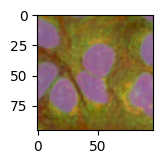

118


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


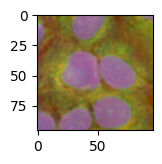

119


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


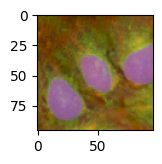

120


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


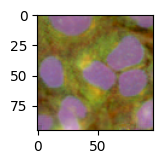

121


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


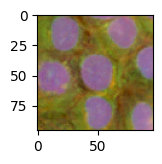

122


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


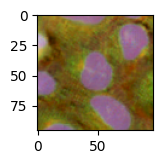

123


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


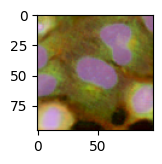

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


124


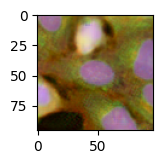

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


125


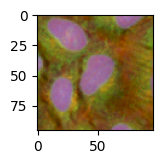

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


126


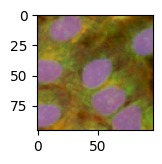

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


127


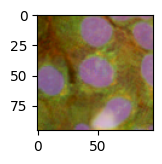

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


128


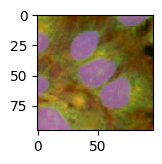

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


129


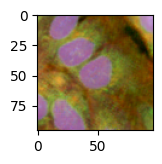

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


130


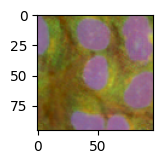

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


131


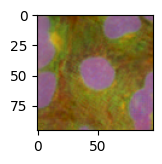

132


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


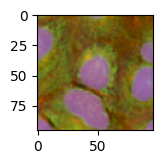

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


133


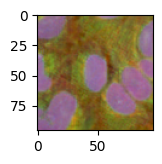

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


134


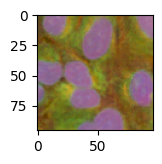

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


135


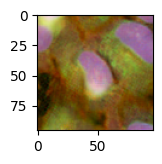

136


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


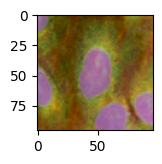

137


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


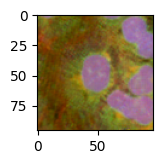

138


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


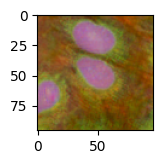

139


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


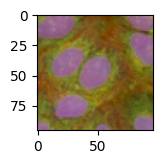

140


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


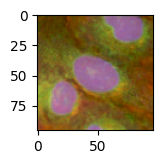

141


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


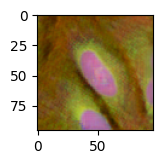

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


142


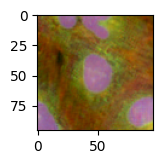

143


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


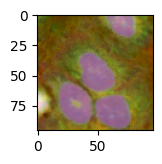

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


144


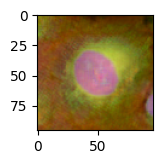

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


145


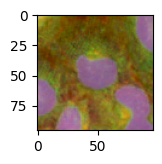

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


146


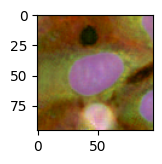

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


147


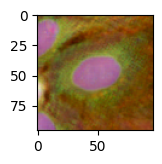

148


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


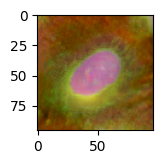

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


149


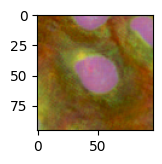

150


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


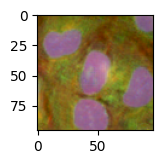

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


151


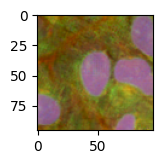

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


152


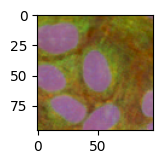

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


153


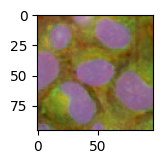

154


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


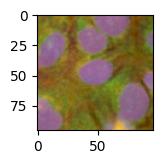

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


155


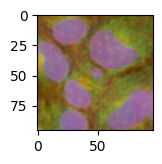

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


156


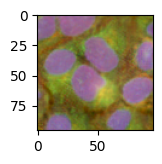

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


157


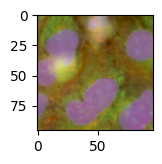

158


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


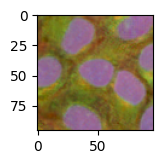

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


159


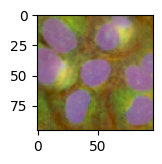

160


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


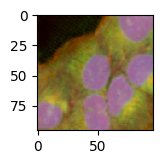

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


161


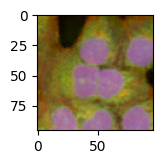

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


162


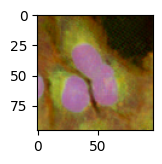

163


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


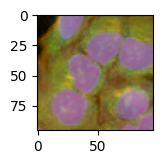

164


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


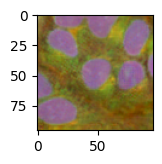

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


165


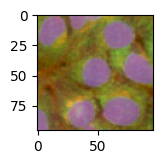

166


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


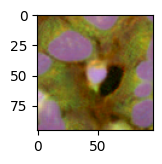

167


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


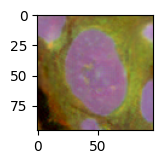

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


168


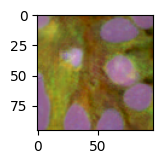

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


169


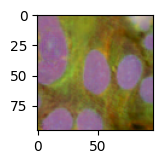

170


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


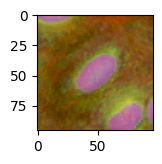

171


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


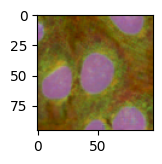

172


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


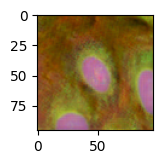

173


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


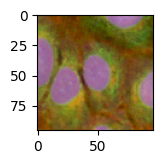

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


174


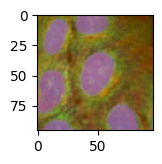

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


175


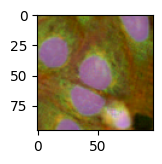

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


176


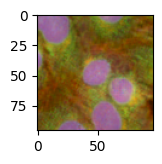

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


177


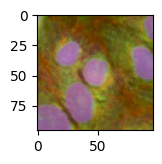

178


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


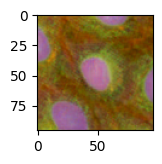

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


179


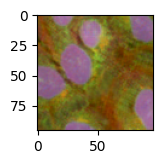

180


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


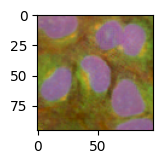

181


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


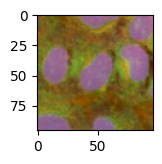

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


182


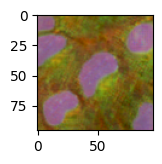

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


183


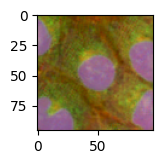

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


184


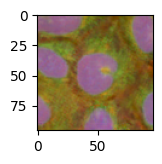

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


185


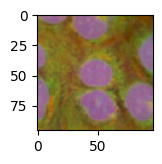

186


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


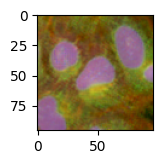

187


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


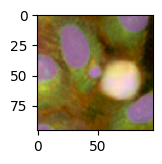

188


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


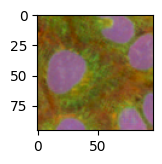

189


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


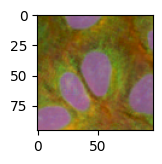

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


190


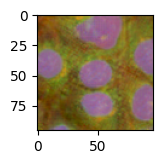

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


191


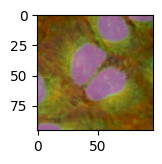

192


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


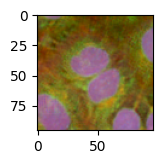

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


193


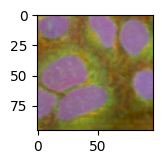

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


194


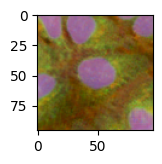

195


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


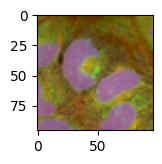

196


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


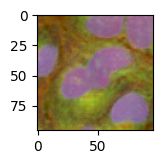

197


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


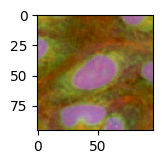

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


198


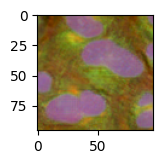

199


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


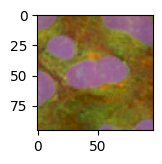

200


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


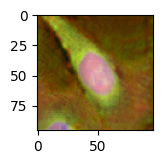

201


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


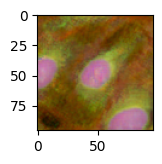

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


202


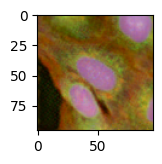

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


203


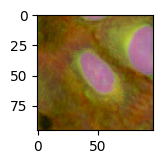

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


204


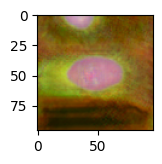

205


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


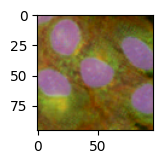

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


206


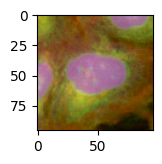

207


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


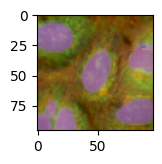

208


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


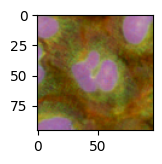

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


209


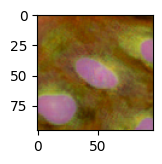

210


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


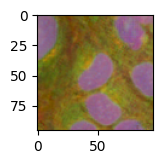

211


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


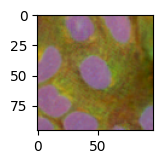

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


212


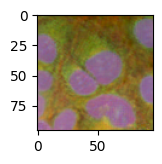

213


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


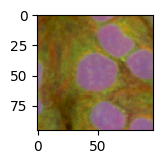

214


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


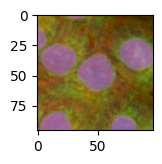

215


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


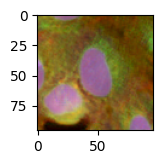

216


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


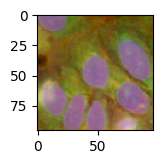

217


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


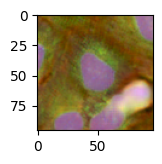

218


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


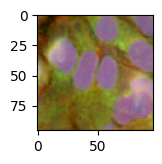

219


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


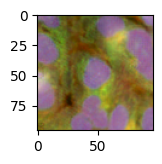

220


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


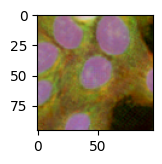

221


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


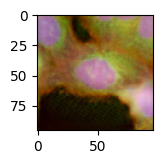

222


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


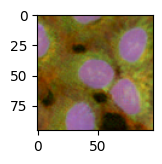

223


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


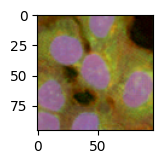

224


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


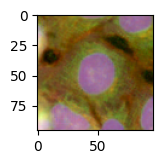

225


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


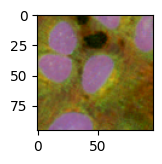

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


226


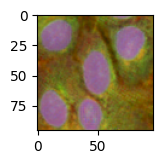

227


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


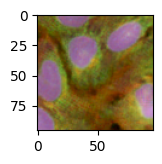

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


228


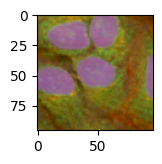

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


229


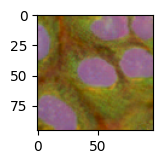

230


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


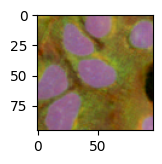

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


231


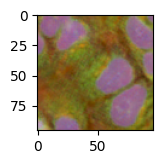

232


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


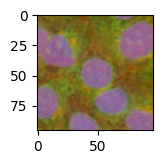

233


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


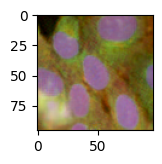

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


234


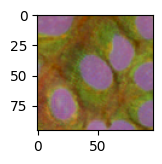

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


235


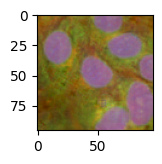

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


236


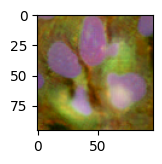

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


237


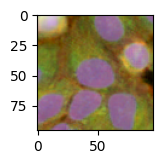

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


238


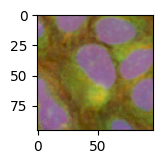

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


239


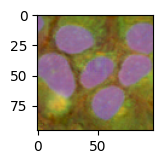

240


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


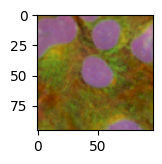

241


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


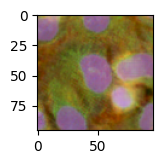

242


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


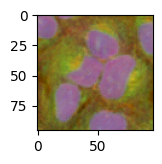

243


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


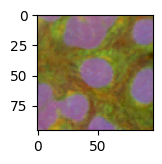

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


244


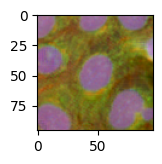

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


245


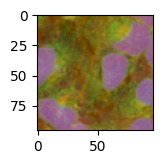

246


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


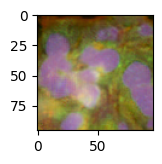

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


247


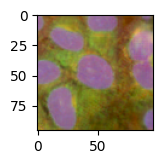

248


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


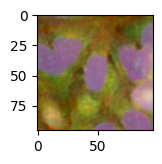

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


249


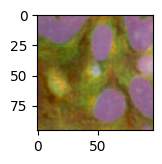

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


250


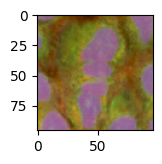

251


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


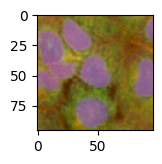

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


252


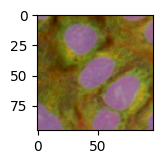

253


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


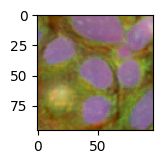

254


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


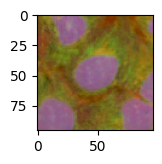

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


255


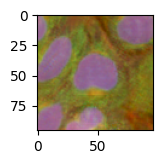

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


256


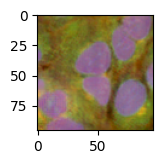

257


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


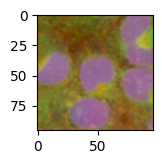

258


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


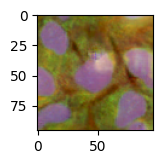

259


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


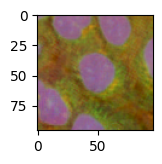

260


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


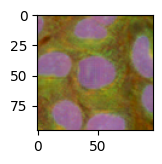

261


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


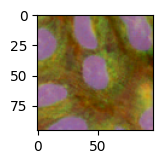

262


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


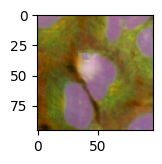

263


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


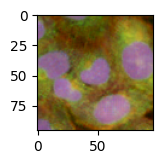

264


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


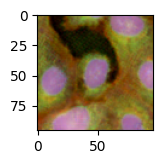

265


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


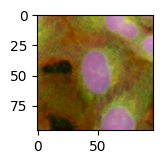

266


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


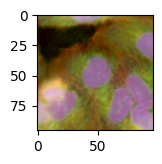

267


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


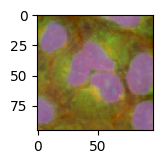

268


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


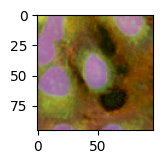

269


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


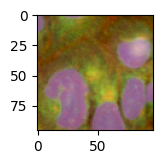

270


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


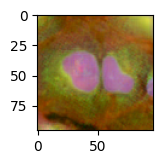

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


271


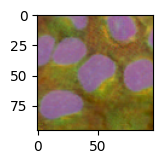

272


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


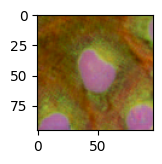

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


273


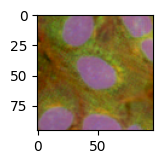

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


274


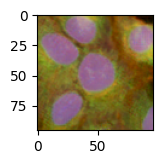

275


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


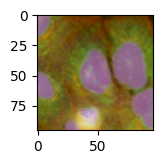

276


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


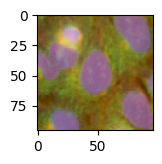

277


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


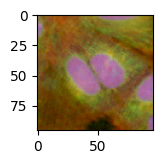

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


278


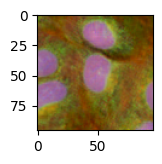

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


279


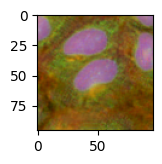

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


280


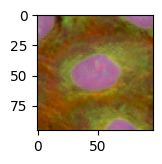

281


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


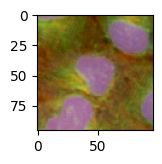

282


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


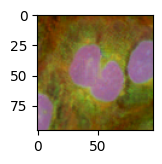

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


283


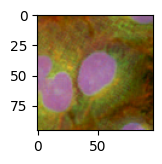

284


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


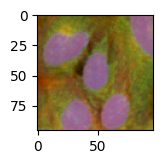

285


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


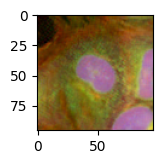

286


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


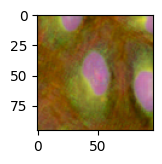

287


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


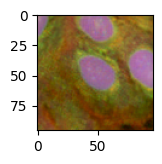

288


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


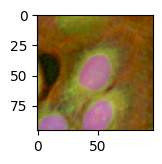

289


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


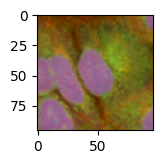

290


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


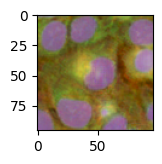

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


291


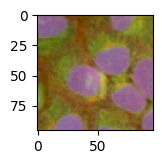

292


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


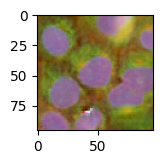

293


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


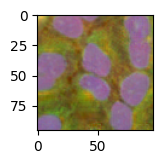

294


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


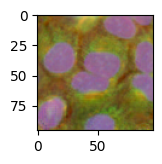

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


295


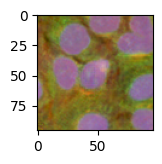

296


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


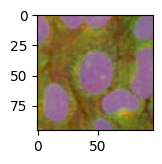

297


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


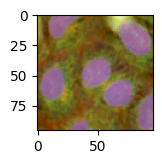

298


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


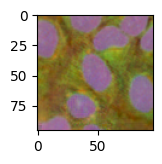

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


299


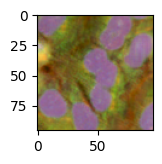

In [17]:
for i in range(300):
    print(i)
    plt.figure(figsize=(1.5,1.5))
    plt.imshow((X_after_transf_impa[real_batch==1][i,[5, 1, 0],:,:].permute(1,2,0).cpu().numpy()+1)/2)
    plt.show()

0


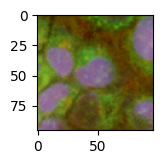

1


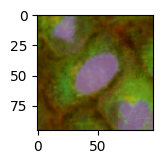

2


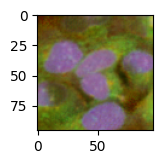

3


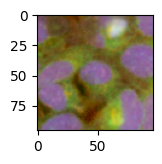

4


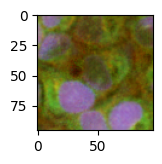

5


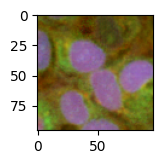

6


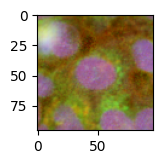

7


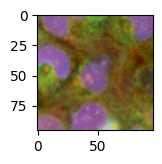

8


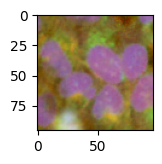

9


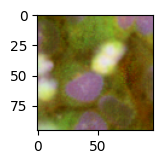

10


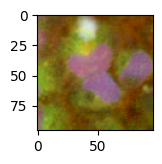

11


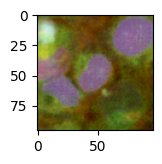

12


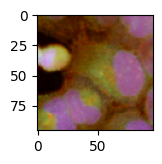

13


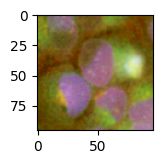

14


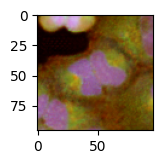

15


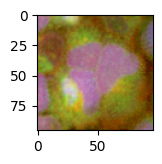

16


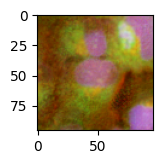

17


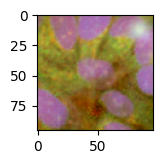

18


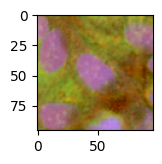

19


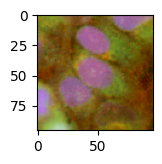

20


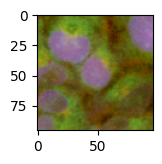

21


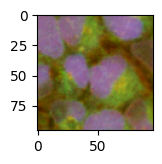

22


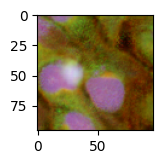

23


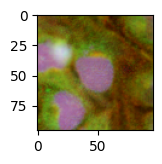

24


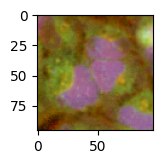

25


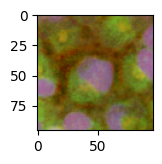

26


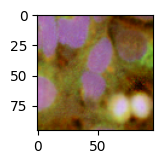

27


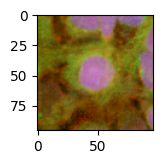

28


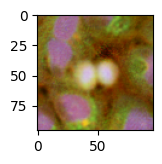

29


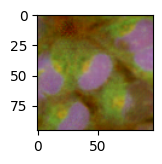

30


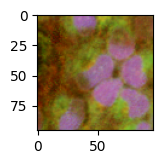

31


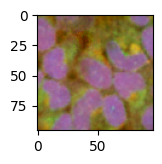

32


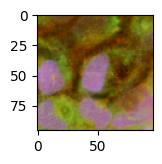

33


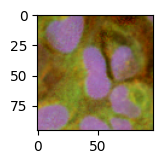

34


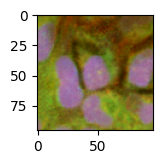

35


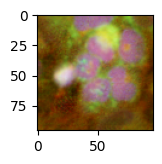

36


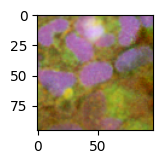

37


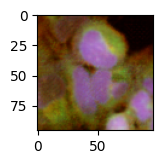

38


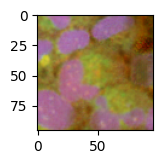

39


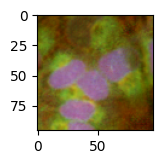

40


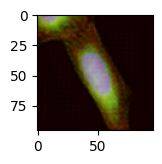

41


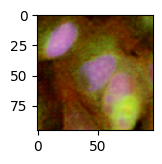

42


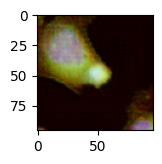

43


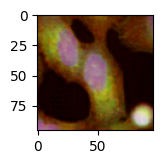

44


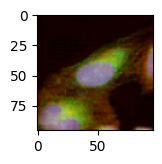

45


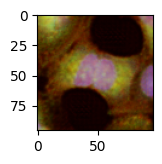

46


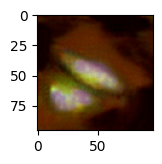

47


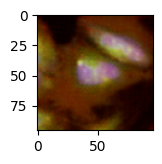

48


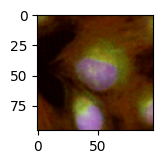

49


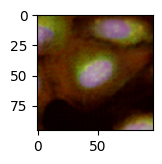

50


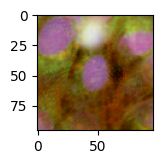

51


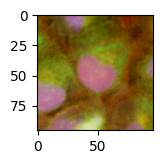

52


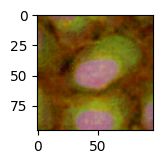

53


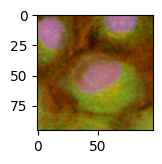

54


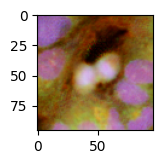

55


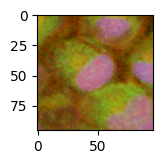

56


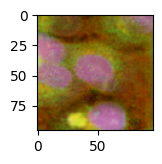

57


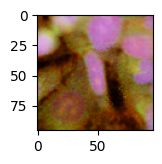

58


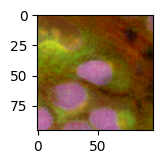

59


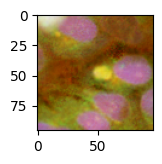

60


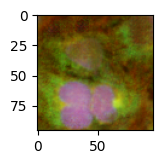

61


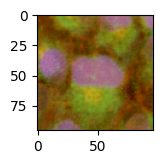

62


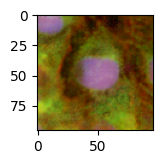

63


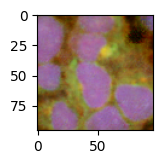

64


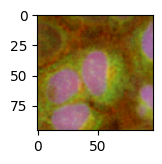

65


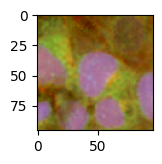

66


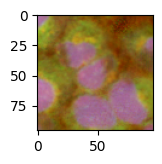

67


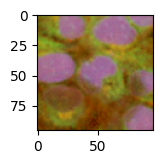

68


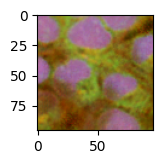

69


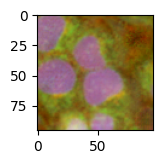

70


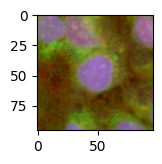

71


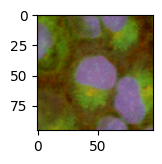

72


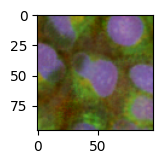

73


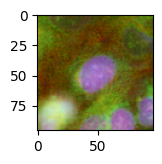

74


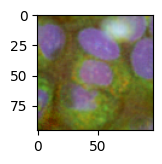

75


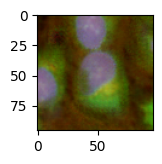

76


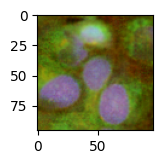

77


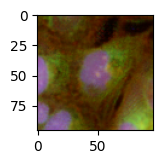

78


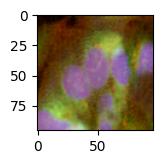

79


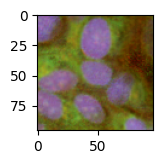

80


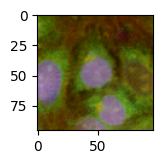

81


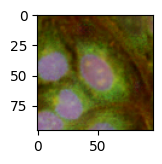

82


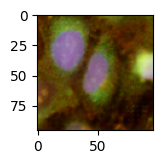

83


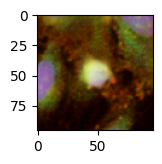

84


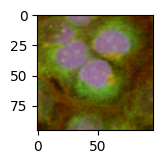

85


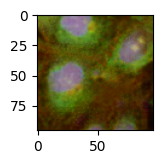

86


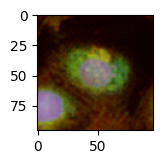

87


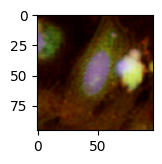

88


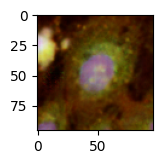

89


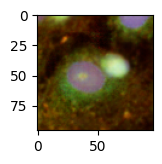

90


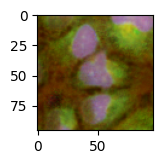

91


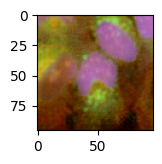

92


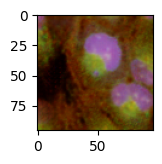

93


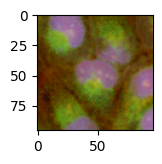

94


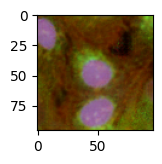

95


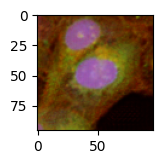

96


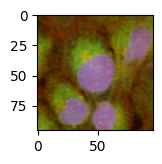

97


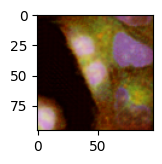

98


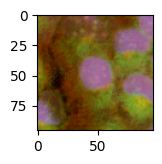

99


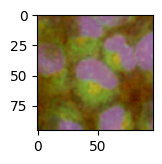

100


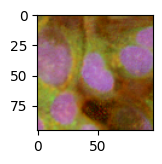

101


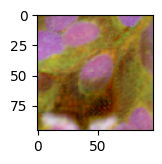

102


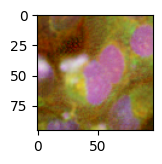

103


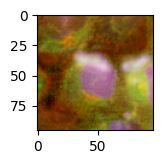

104


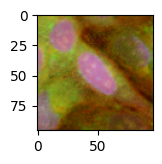

105


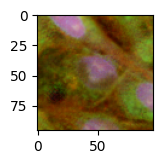

106


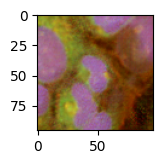

107


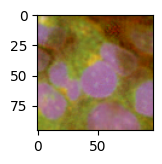

108


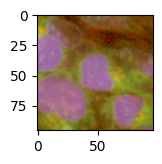

109


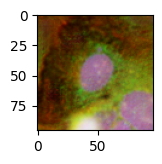

110


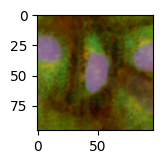

111


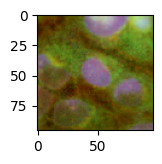

112


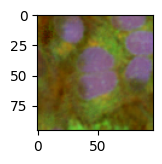

113


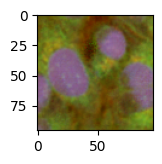

114


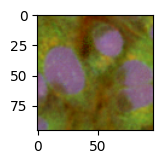

115


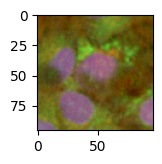

116


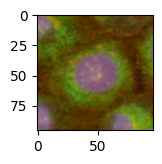

117


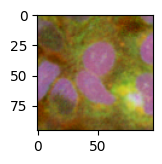

118


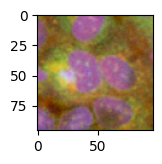

119


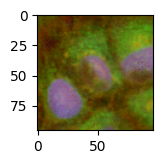

120


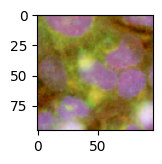

121


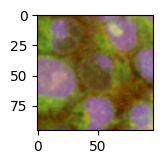

122


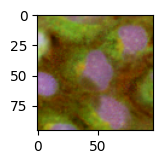

123


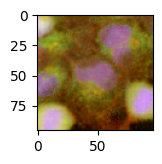

124


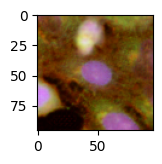

125


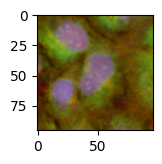

126


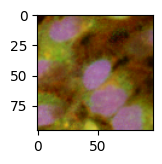

127


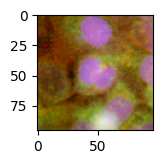

128


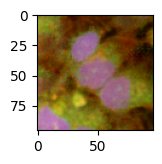

129


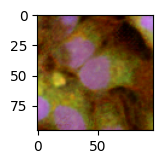

130


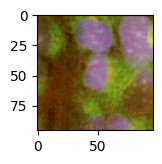

131


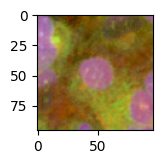

132


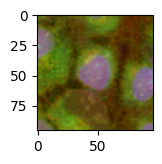

133


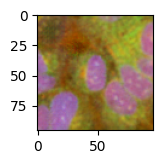

134


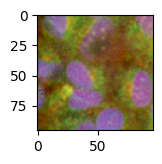

135


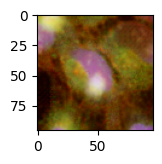

136


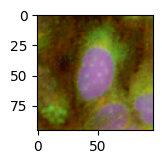

137


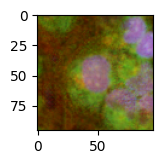

138


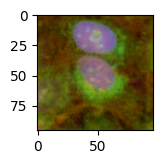

139


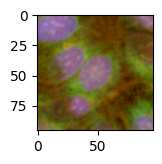

140


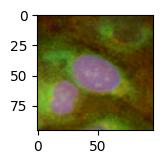

141


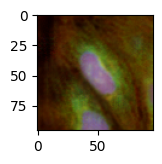

142


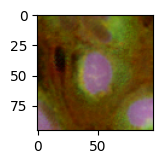

143


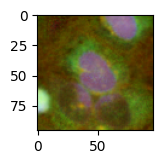

144


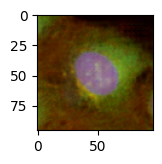

145


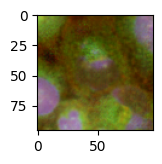

146


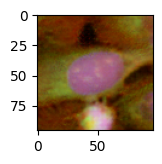

147


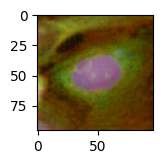

148


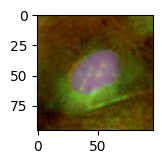

149


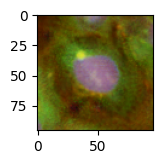

150


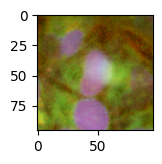

151


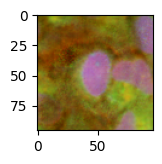

152


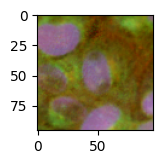

153


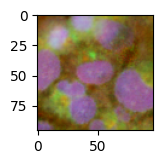

154


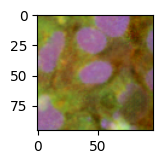

155


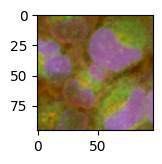

156


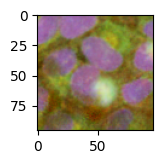

157


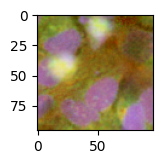

158


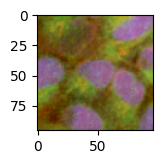

159


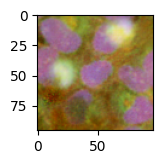

160


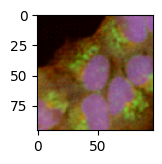

161


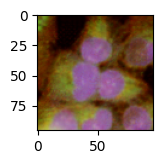

162


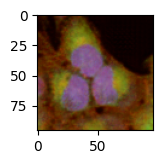

163


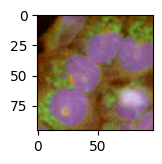

164


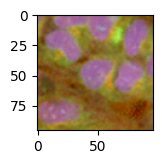

165


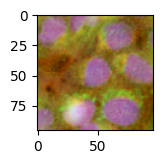

166


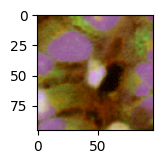

167


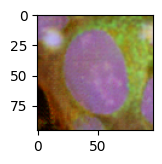

168


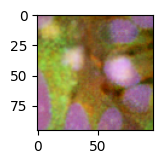

169


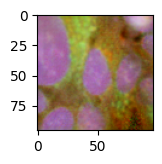

170


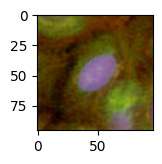

171


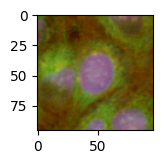

172


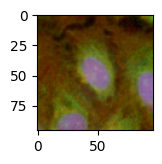

173


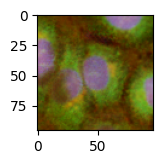

174


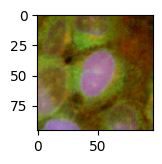

175


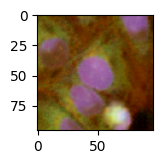

176


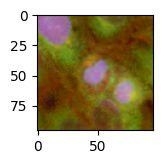

177


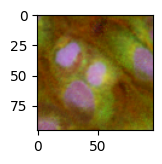

178


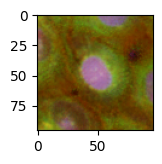

179


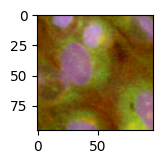

180


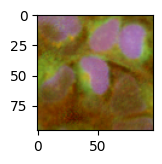

181


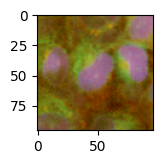

182


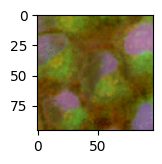

183


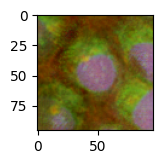

184


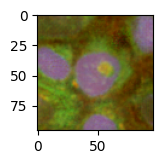

185


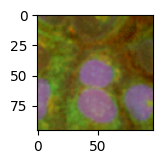

186


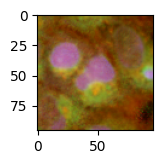

187


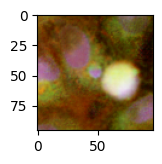

188


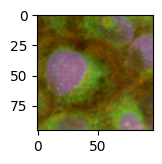

189


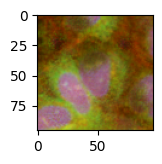

190


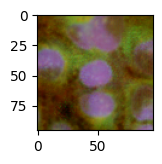

191


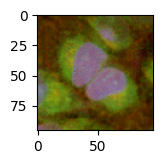

192


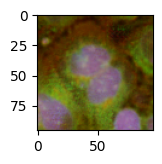

193


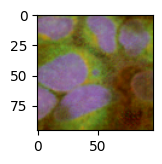

194


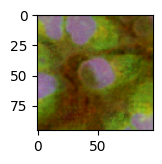

195


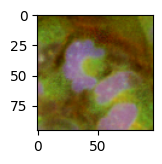

196


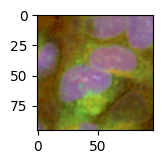

197


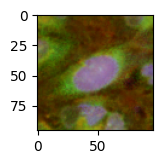

198


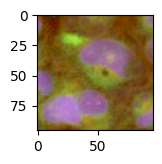

199


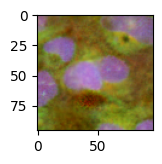

200


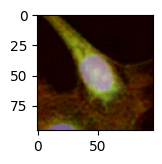

201


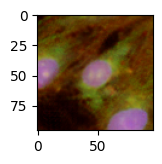

202


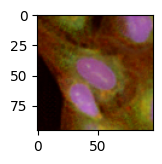

203


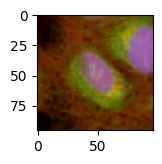

204


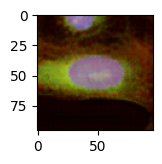

205


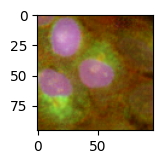

206


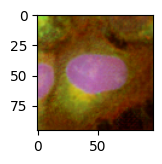

207


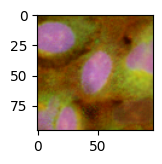

208


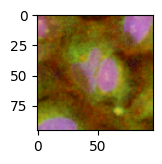

209


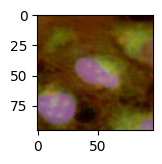

210


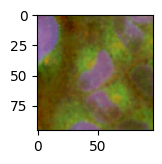

211


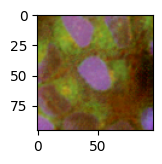

212


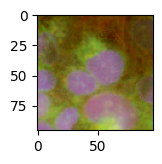

213


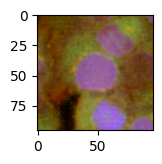

214


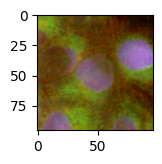

215


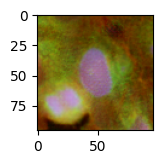

216


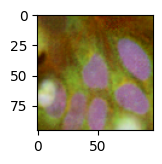

217


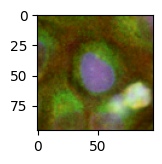

218


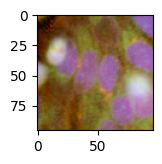

219


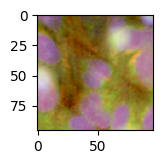

220


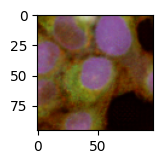

221


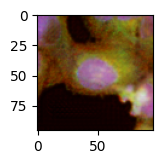

222


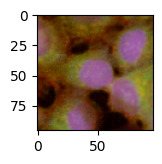

223


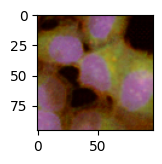

224


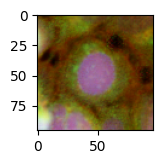

225


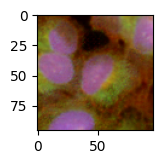

226


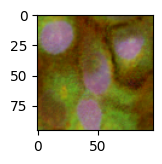

227


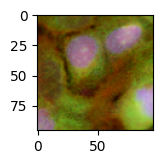

228


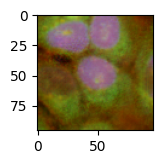

229


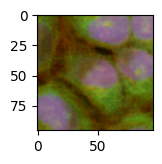

230


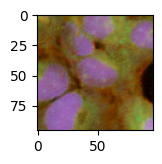

231


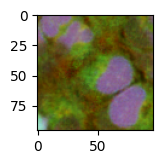

232


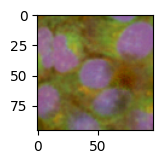

233


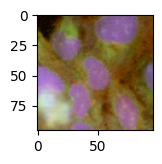

234


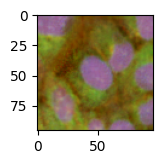

235


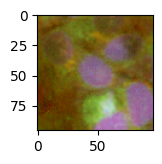

236


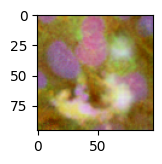

237


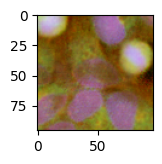

238


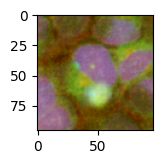

239


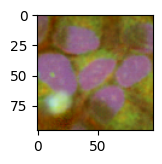

240


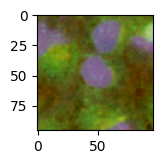

241


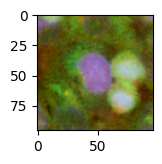

242


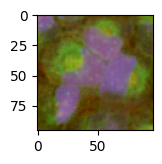

243


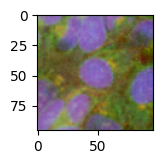

244


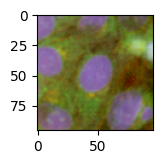

245


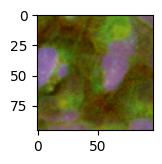

246


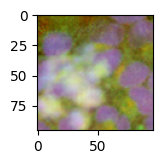

247


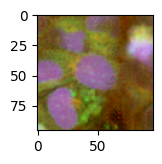

248


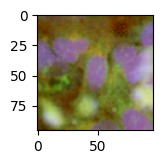

249


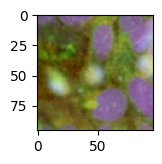

250


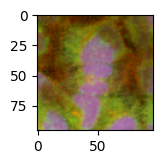

251


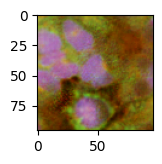

252


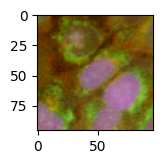

253


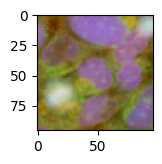

254


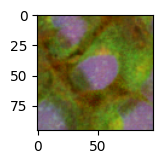

255


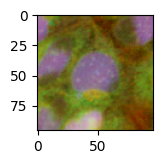

256


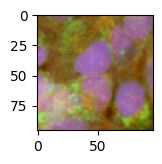

257


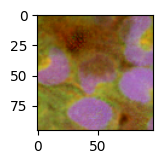

258


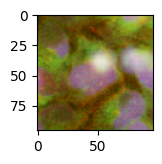

259


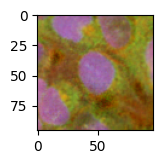

260


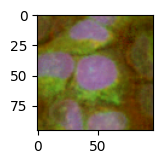

261


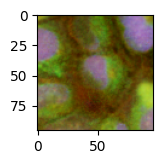

262


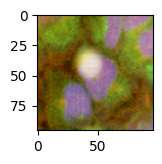

263


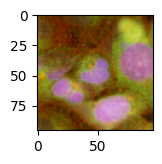

264


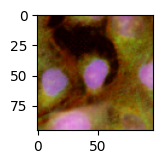

265


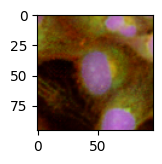

266


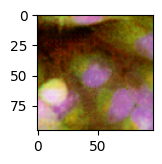

267


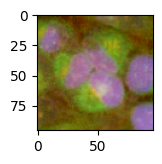

268


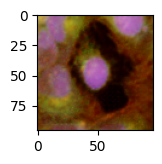

269


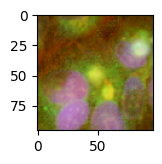

270


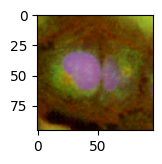

271


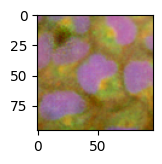

272


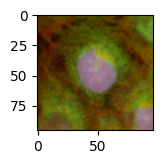

273


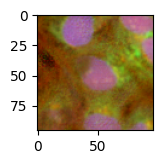

274


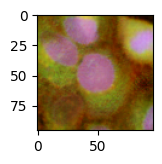

275


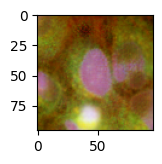

276


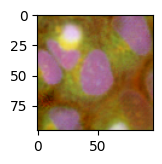

277


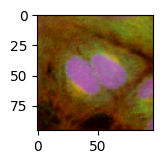

278


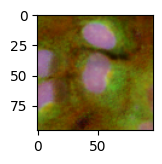

279


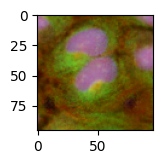

280


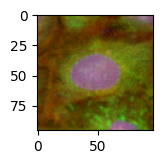

281


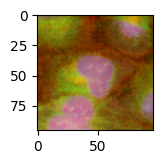

282


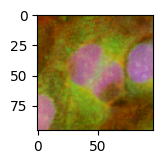

283


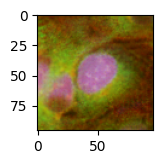

284


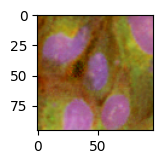

285


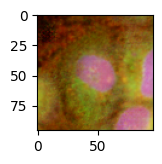

286


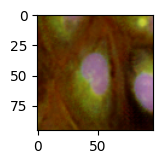

287


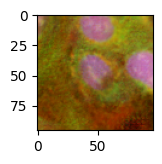

288


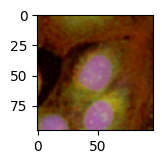

289


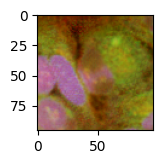

290


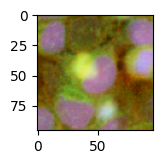

291


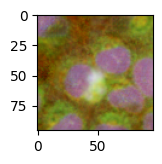

292


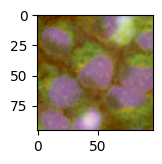

293


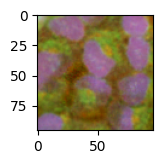

294


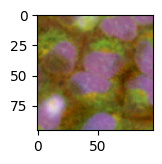

295


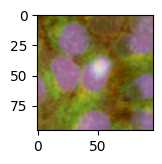

296


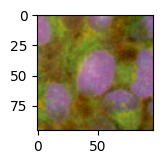

297


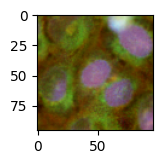

298


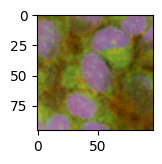

299


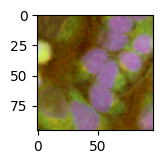

In [18]:
for i in range(300):
    print(i)
    plt.figure(figsize=(1.5,1.5))
    plt.imshow((X_after_transf_stargan[real_batch==1][i,[5, 1, 0],:,:].permute(1,2,0).cpu().numpy()+1)/2)
    plt.show()

0


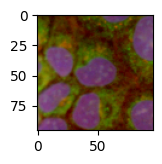

1


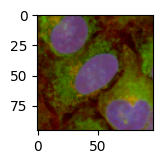

2


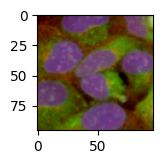

3


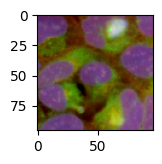

4


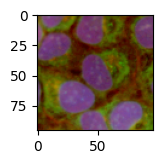

5


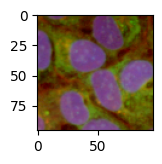

6


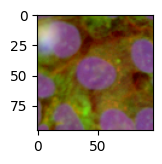

7


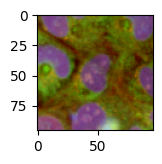

8


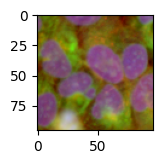

9


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


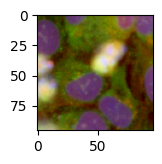

10


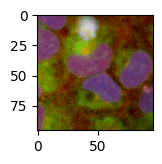

11


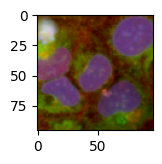

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


12


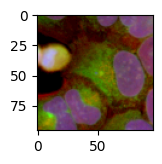

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


13


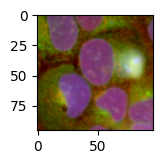

14


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


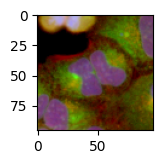

15


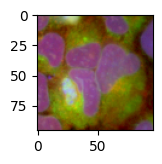

16


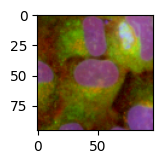

17


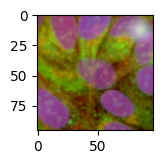

18


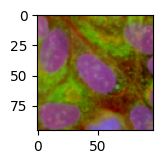

19


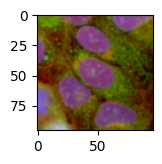

20


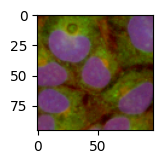

21


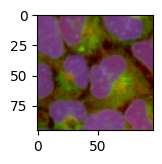

22


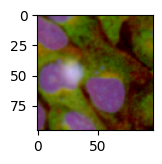

23


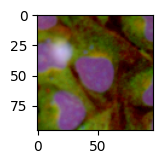

24


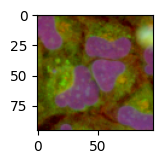

25


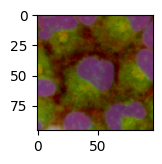

26


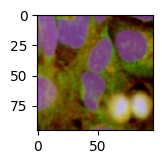

27


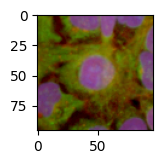

28


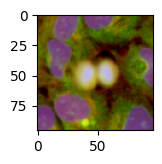

29


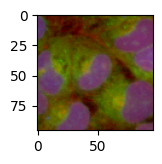

30


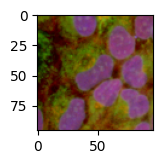

31


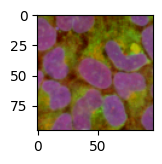

32


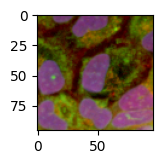

33


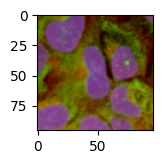

34


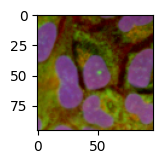

35


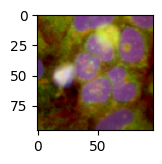

36


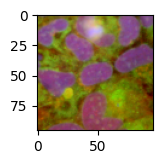

37


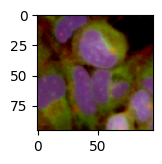

38


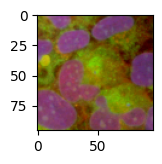

39


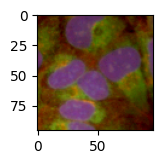

40


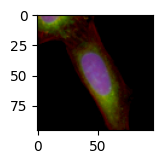

41


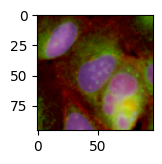

42


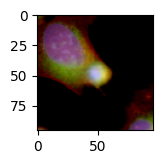

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


43


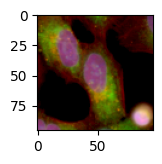

44


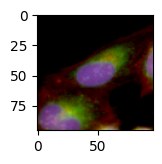

45


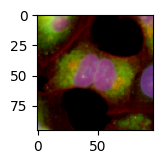

46


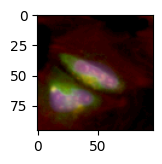

47


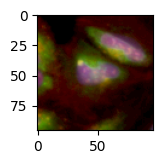

48


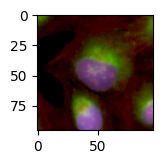

49


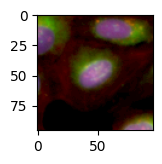

50


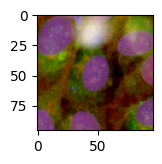

51


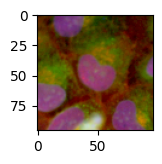

52


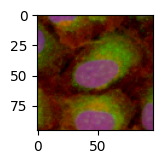

53


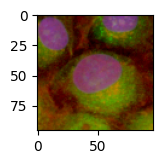

54


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


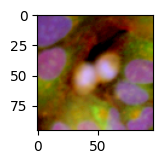

55


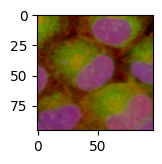

56


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


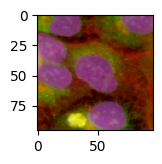

57


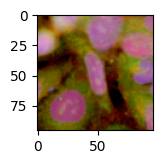

58


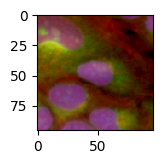

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


59


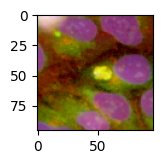

60


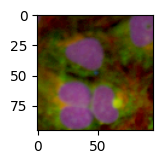

61


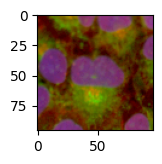

62


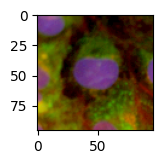

63


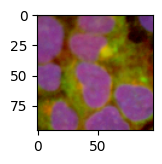

64


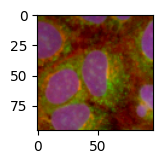

65


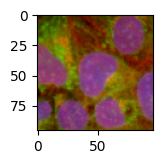

66


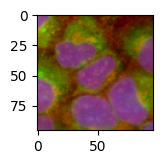

67


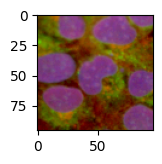

68


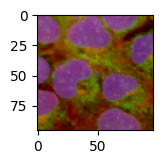

69


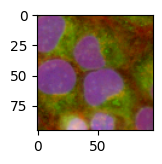

70


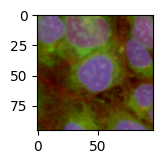

71


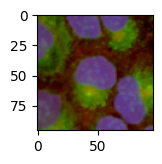

72


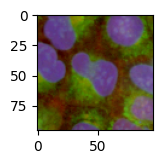

73


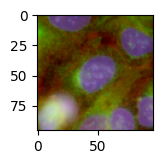

74


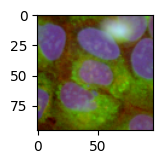

75


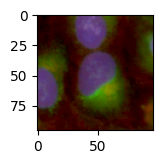

76


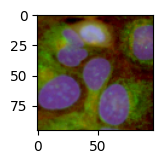

77


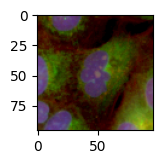

78


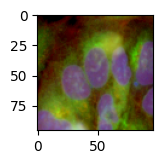

79


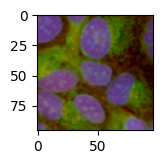

80


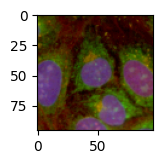

81


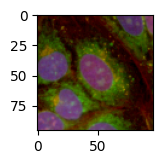

82


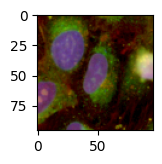

83


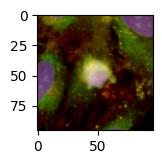

84


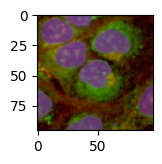

85


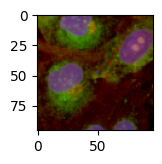

86


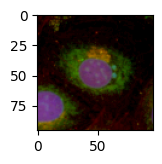

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


87


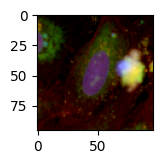

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


88


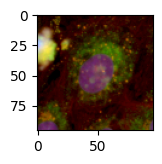

89


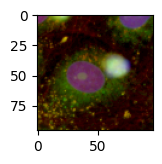

90


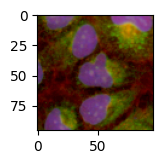

91


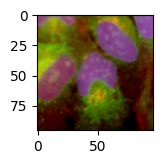

92


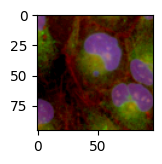

93


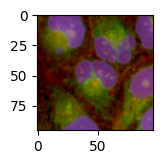

94


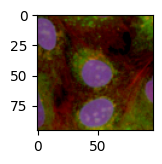

95


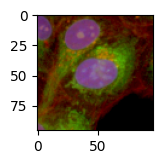

96


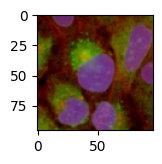

97


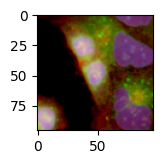

98


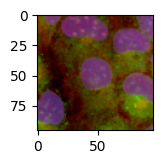

99


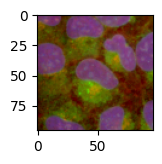

100


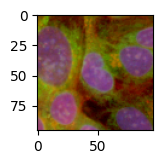

101


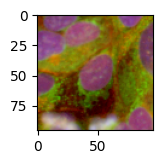

102


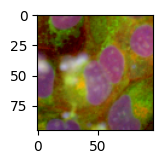

103


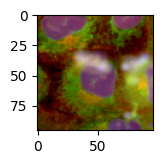

104


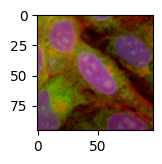

105


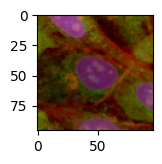

106


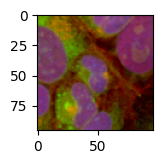

107


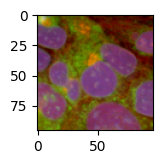

108


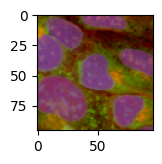

109


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


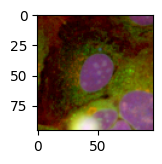

110


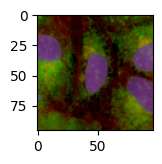

111


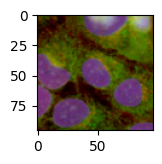

112


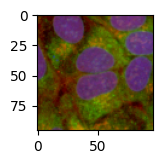

113


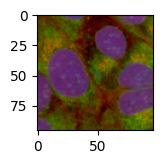

114


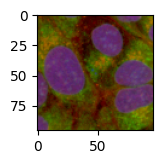

115


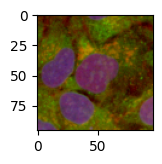

116


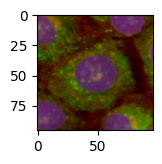

117


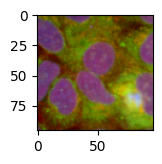

118


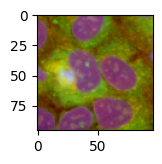

119


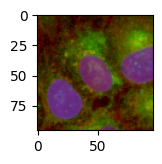

120


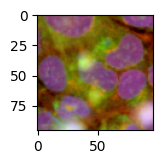

121


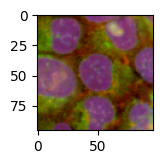

122


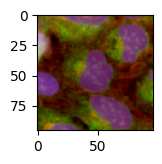

123


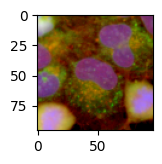

124


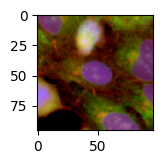

125


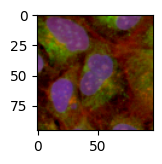

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


126


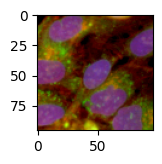

127


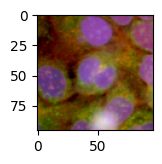

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


128


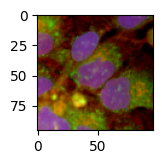

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


129


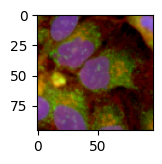

130


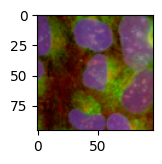

131


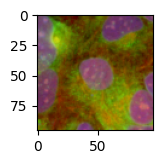

132


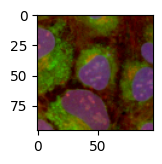

133


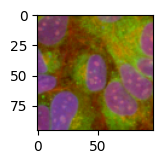

134


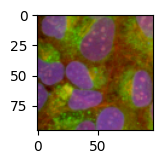

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


135


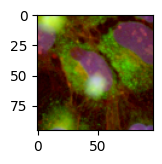

136


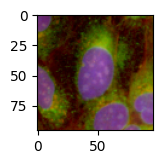

137


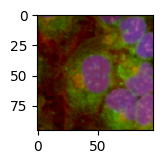

138


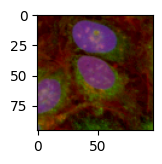

139


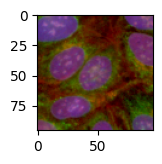

140


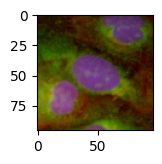

141


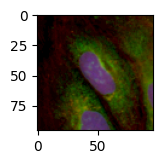

142


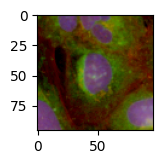

143


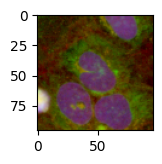

144


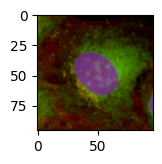

145


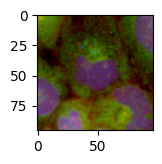

146


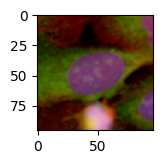

147


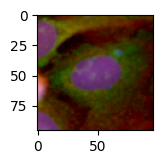

148


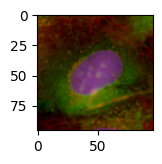

149


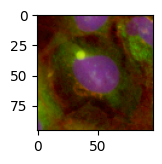

150


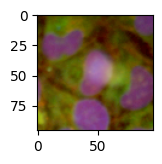

151


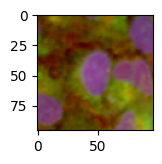

152


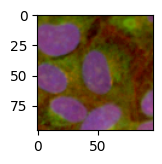

153


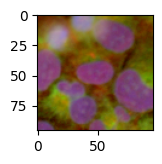

154


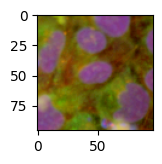

155


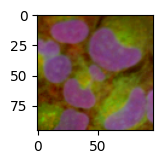

156


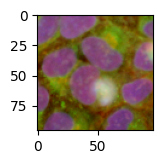

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


157


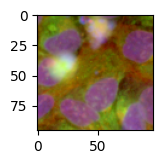

158


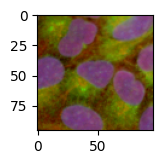

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


159


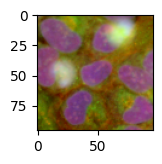

160


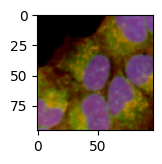

161


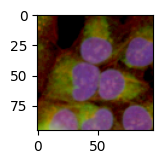

162


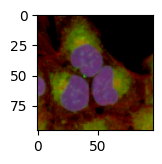

163


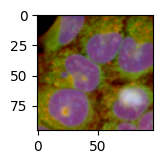

164


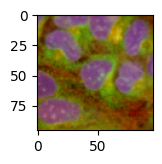

165


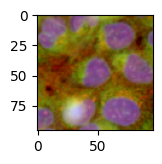

166


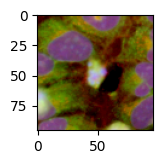

167


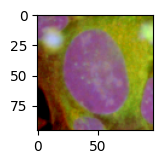

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


168


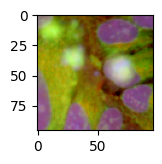

169


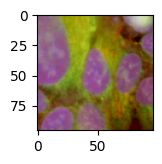

170


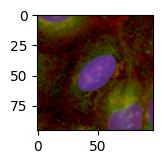

171


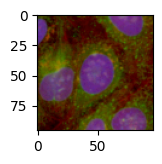

172


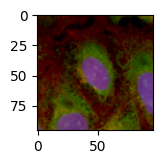

173


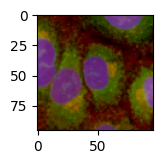

174


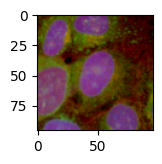

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


175


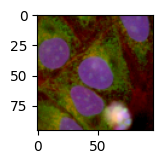

176


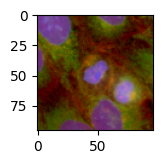

177


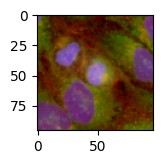

178


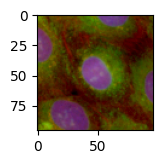

179


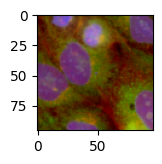

180


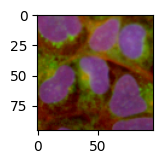

181


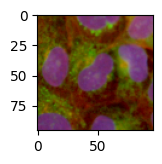

182


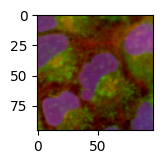

183


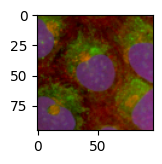

184


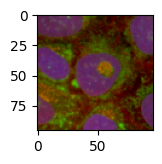

185


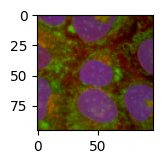

186


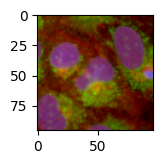

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


187


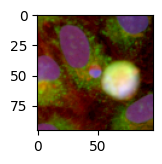

188


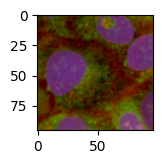

189


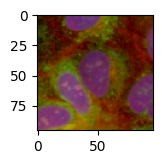

190


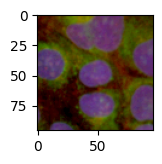

191


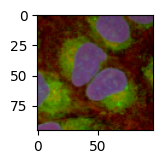

192


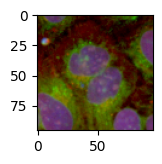

193


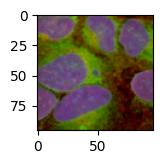

194


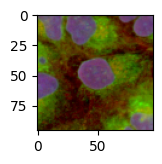

195


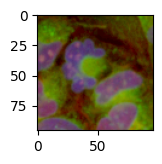

196


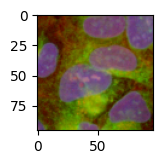

197


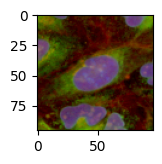

198


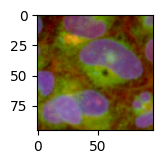

199


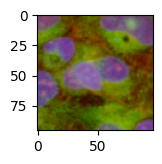

200


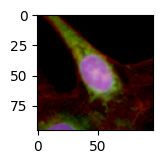

201


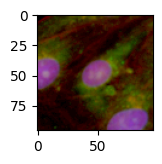

202


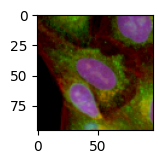

203


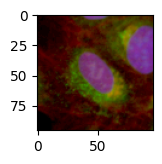

204


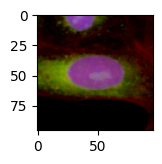

205


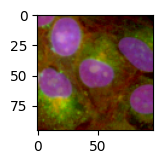

206


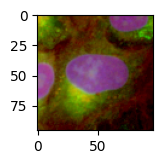

207


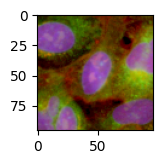

208


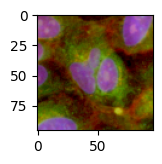

209


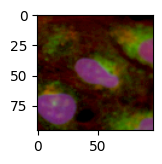

210


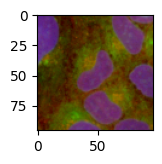

211


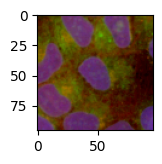

212


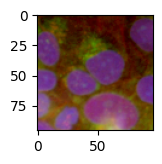

213


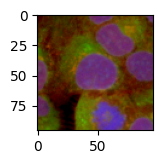

214


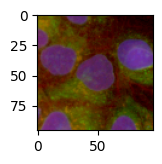

215


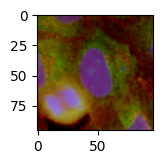

216


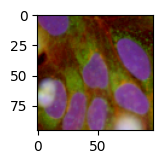

217


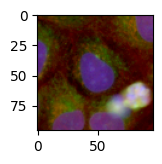

218


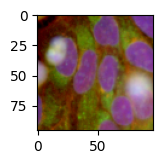

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


219


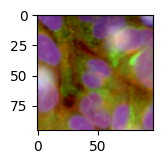

220


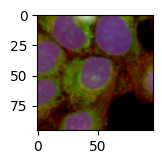

221


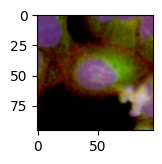

222


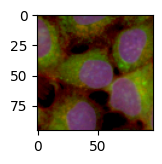

223


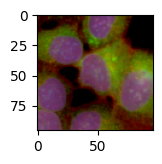

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


224


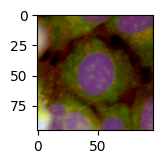

225


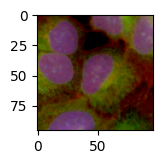

226


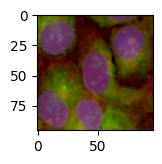

227


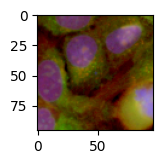

228


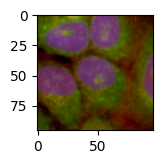

229


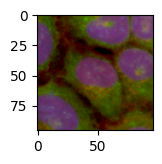

230


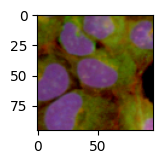

231


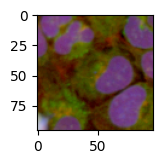

232


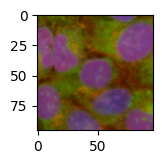

233


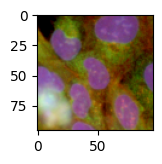

234


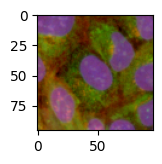

235


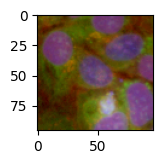

236


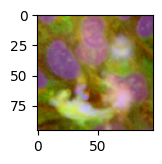

237


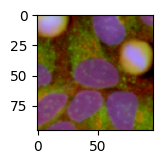

238


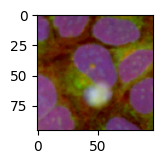

239


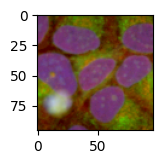

240


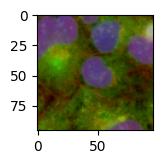

241


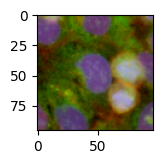

242


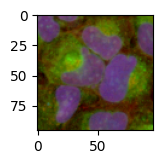

243


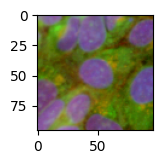

244


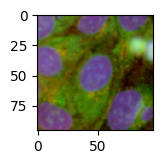

245


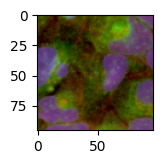

246


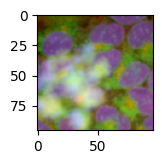

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


247


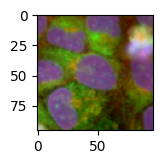

248


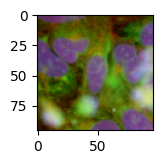

249


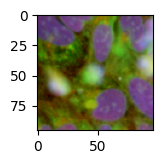

250


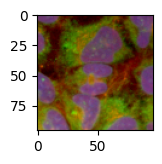

251


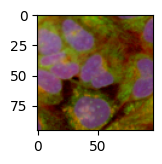

252


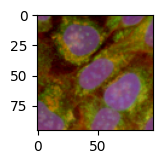

253


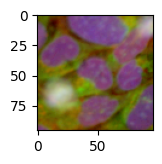

254


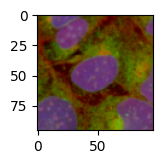

255


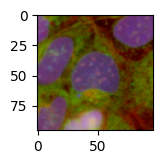

256


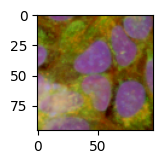

257


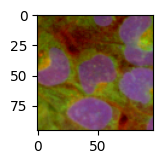

258


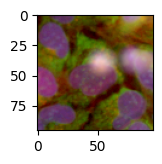

259


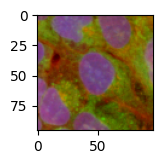

260


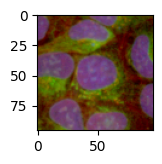

261


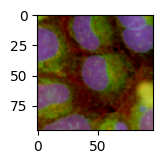

262


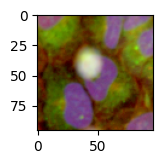

263


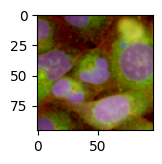

264


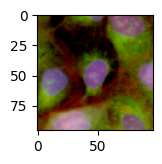

265


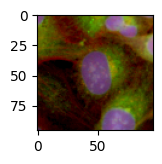

266


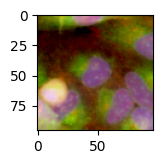

267


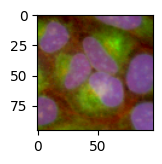

268


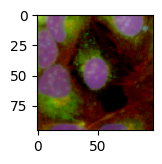

269


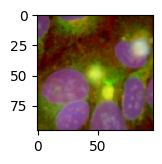

270


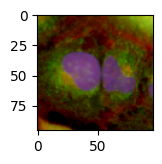

271


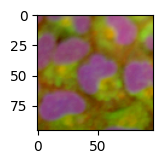

272


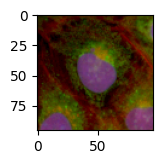

273


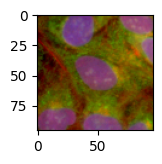

274


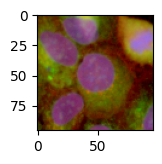

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


275


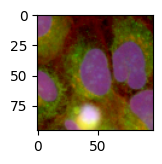

276


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


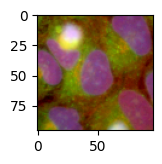

277


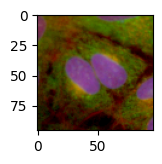

278


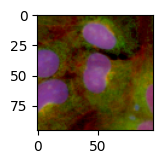

279


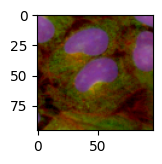

280


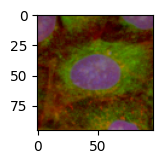

281


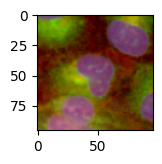

282


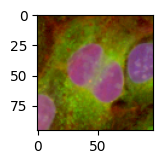

283


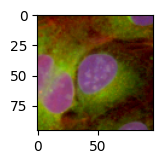

284


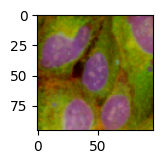

285


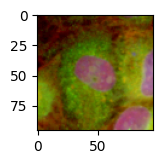

286


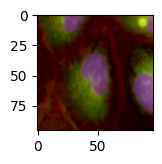

287


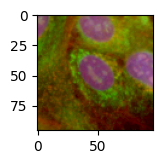

288


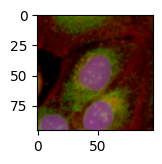

289


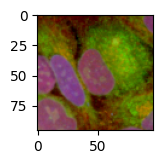

290


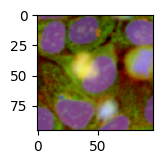

291


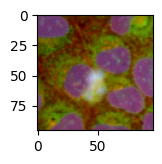

292


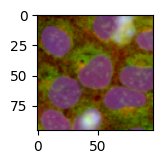

293


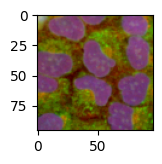

294


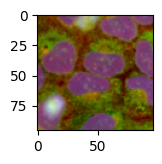

295


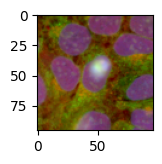

296


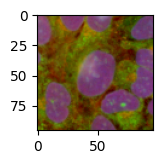

297


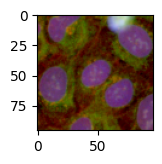

298


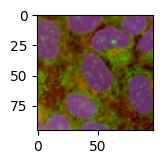

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


299


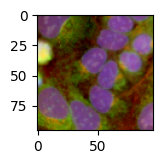

In [16]:
for i in range(300):
    print(i)
    plt.figure(figsize=(1.5,1.5))
    plt.imshow((X_before_transf_1[i,[5, 1, 0],:,:].permute(1,2,0).cpu().numpy()+1)/2)
    plt.show()

In [27]:
pd.read_csv("/home/icb/alessandro.palma/environment/IMPA/IMPA/project_folder/datasets/rxrx1/metadata/rxrx1_df.csv")

,Unnamed: 0,SAMPLE_KEY,BATCH,PLATE,WELL,VIEW,CPD_NAME,ANNOT,CELL_LINE,DOSE,SPLIT
0,0,U2OS-01_1_B02_s1_14,U2OS-01,1,B02,s1,UNTREATED,negative_control,U2OS,NaN,train
1,1,U2OS-01_1_B02_s1_15,U2OS-01,1,B02,s1,UNTREATED,negative_control,U2OS,NaN,train
2,2,U2OS-01_1_B02_s1_16,U2OS-01,1,B02,s1,UNTREATED,negative_control,U2OS,NaN,train
3,3,U2OS-01_1_B02_s1_17,U2OS-01,1,B02,s1,UNTREATED,negative_control,U2OS,NaN,test
4,4,U2OS-01_1_B02_s1_19,U2OS-01,1,B02,s1,UNTREATED,negative_control,U2OS,NaN,train
...,...,...,...,...,...,...,...,...,...,...,...
170938,181260,U2OS-03_3_O23_s2_8,U2OS-03,3,O23,s2,TSFM,treated,U2OS,NaN,train
170939,181261,U2OS-03_3_O23_s2_9,U2OS-03,3,O23,s2,TSFM,treated,U2OS,NaN,test
170940,181262,U2OS-03_3_O23_s2_10,U2OS-03,3,O23,s2,TSFM,treated,U2OS,NaN,train
170941,181263,U2OS-03_3_O23_s2_11,U2OS-03,3,O23,s2,TSFM,treated,U2OS,NaN,train
